# 🛰️ Multitemporal Satellite Change Detection (LEVIR-CD + OSCD)

## Objective
Build a robust pipeline to detect land cover changes across multiple timepoints and test generalization across different datasets.

## Datasets
- **LEVIR-CD:** Used for training. Urban aerial images with pixel-level change annotations at two timepoints.
- **OSCD (Onera Satellite Change Detection):** Used for out-of-domain testing. Contains Sentinel-2 multispectral image pairs with change/no-change labels.
- **LEVIR-CD is high-res urban RGB; OSCD is coarser, multispectral Sentinel-2**

#### LEVIR-CD
- **Type:** High-resolution urban aerial imagery (RGB)
- **Images:** 637 paired images (before/after), each 1024 × 1024 pixels

#### OSCD (Onera Satellite Change Detection)
- **Type:** Medium-resolution multispectral satellite imagery (Sentinel-2, 13 bands)
- **Images:** 24 image pairs from globally distributed sites

## Why Use Multiple Datasets?
Training on one benchmark and testing on another is the gold standard for evaluating model robustness and real-world potential in satellite change detection.

## Workflow Overview
1. **Load & preprocess LEVIR-CD** (train/val/test splits)
2. **Train deep learning model** on LEVIR-CD (multitemporal RGB pairs)
3. **Evaluate on LEVIR-CD** (val/test)
4. **Load & preprocess OSCD (ALL AREAS)**
5. **Evaluate LEVIR-trained model on the entire OSCD dataset**
6. **Visualize & analyze results to assess generalization**

---

In [1]:
 !pip install segmentation-models-pytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 91.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 64.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 76.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalli

In [2]:
import os
import numpy as np
import cv2
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import albumentations as A
import segmentation_models_pytorch as smp
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, jaccard_score, confusion_matrix, cohen_kappa_score, precision_score, recall_score

# Loading and Preprocessing the LEVIR-CD Dataset

In [3]:

def load_levir_dataset(path, img_size=(256, 256), max_samples=None):
    """Load LEVIR-CD dataset """
    if not os.path.exists(path):
        raise FileNotFoundError(f"Dataset path {path} does not exist")
        
    print(f"Contents of {path}:")
    for item in os.listdir(path):
        item_path = os.path.join(path, item)
        if os.path.isdir(item_path):
            print(f"  {item}/ (contains {len(os.listdir(item_path))} files)")
        else:
            print(f"  {item}")
            
    splits = ['train', 'val', 'test']
    all_img1, all_img2, all_mask = [], [], []
    
    for split in splits:
        split_path = os.path.join(path, split)
        if not os.path.exists(split_path):
            print(f"Warning: {split} directory not found, skipping...")
            continue
            
        # Check required directories within split
        required_dirs = ['A', 'B', 'label']
        missing_dirs = []
        for dir_name in required_dirs:
            dir_path = os.path.join(split_path, dir_name)
            if not os.path.exists(dir_path):
                missing_dirs.append(dir_name)
        
        if missing_dirs:
            print(f"Warning: Missing directories in {split}: {missing_dirs}, skipping...")
            continue
        
        # Get file IDs for this split
        a_files = os.listdir(os.path.join(split_path, 'A'))
        b_files = os.listdir(os.path.join(split_path, 'B'))
        label_files = os.listdir(os.path.join(split_path, 'label'))
        
        print(f"Split {split}: {len(a_files)} files in A/, {len(b_files)} files in B/, {len(label_files)} files in label/")
        
        # Extract IDs more robustly
        ids = []
        for f in a_files:
            if f.endswith('.png'):
                # Handle different naming conventions
                if '_A.' in f:
                    base_id = f.replace('_A.png', '')
                    b_file = f'{base_id}_B.png'
                    label_file = f'{base_id}_label.png'
                else:
                    base_id = f.replace('.png', '')
                    b_file = f'{base_id}.png'
                    label_file = f'{base_id}.png'
                
                if b_file in b_files and label_file in label_files:
                    ids.append((base_id, split))
        
        print(f"Found {len(ids)} valid image pairs in {split}")
        
        # Load images for this split
        split_img1, split_img2, split_mask = [], [], []
        failed_loads = 0
        
        for base_id, split_name in tqdm(ids, desc=f"Loading {split}"):
            try:
                if '_A.' in a_files[0]:  # Check naming convention
                    a_path = os.path.join(split_path, 'A', f'{base_id}_A.png')
                    b_path = os.path.join(split_path, 'B', f'{base_id}_B.png')
                    m_path = os.path.join(split_path, 'label', f'{base_id}_label.png')
                else:
                    a_path = os.path.join(split_path, 'A', f'{base_id}.png')
                    b_path = os.path.join(split_path, 'B', f'{base_id}.png')
                    m_path = os.path.join(split_path, 'label', f'{base_id}.png')

                img1 = cv2.imread(a_path)
                img2 = cv2.imread(b_path)
                mask = cv2.imread(m_path, 0)
                
                if img1 is None or img2 is None or mask is None:
                    failed_loads += 1
                    continue
                
                img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
                img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

                img1 = cv2.resize(img1, img_size)
                img2 = cv2.resize(img2, img_size)
                mask = cv2.resize(mask, img_size, interpolation=cv2.INTER_NEAREST)
                
                # Normalize mask to binary
                mask = (mask > 127).astype(np.uint8)

                split_img1.append(img1.transpose(2, 0, 1) / 255.0)
                split_img2.append(img2.transpose(2, 0, 1) / 255.0)
                split_mask.append(mask)
                
            except Exception as e:
                print(f"Error loading {base_id}: {e}")
                failed_loads += 1
                continue

        if failed_loads > 0:
            print(f"Failed to load {failed_loads} images from {split}")
        
        # Add to overall lists
        all_img1.extend(split_img1)
        all_img2.extend(split_img2)
        all_mask.extend(split_mask)
        
        print(f"Successfully loaded {len(split_img1)} image pairs from {split}")
    
    if len(all_img1) == 0:
        raise ValueError("No valid images were loaded from any split")
    
    # Apply max_samples limit if specified
    if max_samples and len(all_img1) > max_samples:
        indices = np.random.choice(len(all_img1), max_samples, replace=False)
        all_img1 = [all_img1[i] for i in indices]
        all_img2 = [all_img2[i] for i in indices]
        all_mask = [all_mask[i] for i in indices]

    img1 = np.stack(all_img1).astype(np.float32)
    img2 = np.stack(all_img2).astype(np.float32)
    mask = np.stack(all_mask).astype(np.uint8)
    
    print(f"Final dataset: {len(img1)} image pairs")
    print(f"Image shape: {img1.shape}, Mask shape: {mask.shape}")
    print(f"Change ratio: {np.mean(mask):.4f}")
    
    return img1, img2, mask

# Data Augmentation

In [4]:
class ChangeDetectionDataset(Dataset):
    def __init__(self, img1, img2, mask, augmentations=None, is_train=False):
        self.img1 = img1
        self.img2 = img2
        self.mask = mask
        self.augment = augmentations
        self.is_train = is_train

    def __len__(self): 
        return len(self.img1)
    
    def __getitem__(self, idx):
        i1, i2, msk = self.img1[idx], self.img2[idx], self.mask[idx]
        
        if self.is_train and self.augment:
            # Combine images for consistent augmentation
            combined = np.concatenate([i1, i2], axis=0)
            augmented = self.augment(image=combined.transpose(1,2,0), mask=msk)
            combined = augmented['image'].transpose(2,0,1)
            i1, i2 = combined[:3], combined[3:]
            msk = augmented['mask']
        
        # Concatenate images for siamese input
        input_tensor = np.concatenate([i1, i2], axis=0)
        
        return torch.from_numpy(input_tensor).float(), torch.from_numpy(msk).unsqueeze(0).float()

def get_augs():
    return A.Compose([
        A.HorizontalFlip(p=0.5), 
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5), 
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=10, p=0.5),
        A.ElasticTransform(alpha=1, sigma=50, p=0.3), 
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.3),
        A.GaussNoise(var_limit=(10, 50), p=0.2), 
        A.CoarseDropout(max_holes=6, max_height=16, max_width=16, p=0.2)
    ])

# Attention U-Net Model

In [5]:
class AttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super().__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=True)
        
    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi

class AttentionUNet(nn.Module):
    def __init__(self, in_channels=6, out_channels=1, encoder="resnet34"):
        super().__init__()
        
        self.model = smp.Unet(
            encoder_name=encoder,
            encoder_weights=None,  
            in_channels=in_channels,
            classes=out_channels,
            activation=None,  
        )
    
    def forward(self, x):
        return self.model(x)


# I am creating the below function in case  first model fails as Attention model i having some issues in loading intially.

class SimpleUNet(nn.Module):
    def __init__(self, in_channels=6, out_channels=1):
        super().__init__()
        
        # Encoder (Downsampling)
        self.enc1 = self._conv_block(in_channels, 64)
        self.enc2 = self._conv_block(64, 128)
        self.enc3 = self._conv_block(128, 256)
        self.enc4 = self._conv_block(256, 512)
        
        # Bridge
        self.bridge = self._conv_block(512, 1024)
        
        # Decoder (Upsampling)
        self.dec4 = self._upconv_block(1024, 512)
        self.dec3 = self._upconv_block(512, 256)
        self.dec2 = self._upconv_block(256, 128)
        self.dec1 = self._upconv_block(128, 64)
        
        # Final layer
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)
        
        self.pool = nn.MaxPool2d(2)
        
    def _conv_block(self, in_ch, out_ch):
        return nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )
    
    def _upconv_block(self, in_ch, out_ch):
        return nn.Sequential(
            nn.ConvTranspose2d(in_ch, out_ch, 2, stride=2),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool(e1))
        e3 = self.enc3(self.pool(e2))
        e4 = self.enc4(self.pool(e3))
        
        # Bridge
        bridge = self.bridge(self.pool(e4))
        
        # Decoder with skip connections
        d4 = self.dec4(bridge)
        d4 = torch.cat([d4, e4], dim=1)
        d4 = self._conv_block(d4.size(1), 512)(d4)
        
        d3 = self.dec3(d4)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self._conv_block(d3.size(1), 256)(d3)
        
        d2 = self.dec2(d3)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self._conv_block(d2.size(1), 128)(d2)
        
        d1 = self.dec1(d2)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self._conv_block(d1.size(1), 64)(d1)
        
        return self.final(d1)

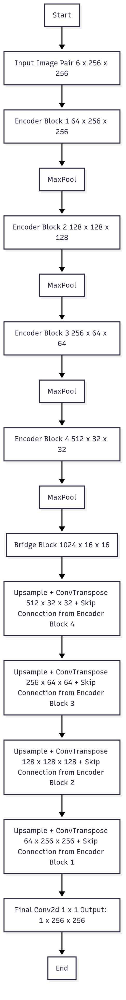

In [6]:
from IPython.display import Image, display
display(Image('../input/flow-chart-image/flow_chart_image.png', height=400))

# Extra Functions  

In [7]:
def multi_scale_predict(model, x, scales=[1.0, 0.75, 1.25]):
    """Multi-scale prediction for better accuracy"""
    model.eval()
    preds = []
    orig_size = x.shape[-2:]
    
    with torch.no_grad():
        for scale in scales:
            if scale != 1.0:
                # Resize input
                new_size = [int(orig_size[0] * scale), int(orig_size[1] * scale)]
                xs = F.interpolate(x, size=new_size, mode='bilinear', align_corners=False)
            else:
                xs = x
            
            # Predict
            pred = model(xs)
            pred = torch.sigmoid(pred)
            
            # Resize back to original size
            if scale != 1.0:
                pred = F.interpolate(pred, size=orig_size, mode='bilinear', align_corners=False)
            
            preds.append(pred)
    
    # Average predictions
    return torch.mean(torch.stack(preds), dim=0)

# Random Forest(Data pre-processing) 

In [8]:
def prepare_rf_data(img1, img2, mask, sample_size=50000):
    """Prepare data for Random Forest training with enhanced features"""
    B, C, H, W = img1.shape
    
    img1_flat = img1.transpose(0, 2, 3, 1).reshape(-1, C) 
    img2_flat = img2.transpose(0, 2, 3, 1).reshape(-1, C)  
    
    # Create feature matrix
    # 1. Original features (concatenated images)
    X_original = np.concatenate([img1_flat, img2_flat], axis=1) 
    
    # 2. Difference features
    X_diff = img2_flat - img1_flat 
    
    # 3. Ratio features (normalized change)
    X_ratio = np.divide(img2_flat, img1_flat + 1e-8) 
    
    # Combine all features
    X = np.concatenate([X_original, X_diff, X_ratio], axis=1) 
    y = mask.reshape(-1)
    
    if len(X) > sample_size:
        idx = np.random.choice(len(X), sample_size, replace=False)
        X, y = X[idx], y[idx]
    
    print(f"RF training data shape: {X.shape}, Features: {X.shape[1]}")
    return X, y

def prepare_rf_inference(img1, img2):
    """Prepare data for Random Forest inference (matches training format)"""
    B, C, H, W = img1.shape
    
    # Flatten images
    img1_flat = img1.transpose(0, 2, 3, 1).reshape(-1, C)
    img2_flat = img2.transpose(0, 2, 3, 1).reshape(-1, C)
    
    X_original = np.concatenate([img1_flat, img2_flat], axis=1)
    X_diff = img2_flat - img1_flat
    X_ratio = np.divide(img2_flat, img1_flat + 1e-8)
    
    X = np.concatenate([X_original, X_diff, X_ratio], axis=1)
    
    return X

# Evaluation metrics

In [9]:
def eval_metrics(y_true, y_pred):
    """Calculate evaluation metrics"""
    y_true_flat = y_true.flatten()
    y_pred_flat = y_pred.flatten()
    
    # Handle edge case where no positive samples exist
    if len(np.unique(y_true_flat)) == 1:
        print("Warning: Only one class present in y_true")
    
    metrics = {}
    try:
        metrics['accuracy'] = accuracy_score(y_true_flat, y_pred_flat)
        metrics['f1'] = f1_score(y_true_flat, y_pred_flat, zero_division=0)
        metrics['iou'] = jaccard_score(y_true_flat, y_pred_flat, zero_division=0)
        metrics['precision'] = precision_score(y_true_flat, y_pred_flat, zero_division=0)
        metrics['recall'] = recall_score(y_true_flat, y_pred_flat, zero_division=0)
        metrics['kappa'] = cohen_kappa_score(y_true_flat, y_pred_flat)
    except Exception as e:
        print(f"Error calculating metrics: {e}")
        metrics = {k: 0.0 for k in ['accuracy', 'f1', 'iou', 'precision', 'recall', 'kappa']}
    
    return metrics

def plot_confusion(y_true, y_pred, title="Confusion Matrix"):
    """Plot confusion matrix"""
    cm = confusion_matrix(y_true.flatten(), y_pred.flatten())
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap='Blues')
    plt.title(title)
    plt.colorbar()
    
    # Add text annotations
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(j, i, format(cm[i, j], 'd'),
                    horizontalalignment="center",
                    color="white" if cm[i, j] > thresh else "black")
    
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()


# Creating pipeline

In [10]:
def train_pipeline(img1, img2, mask, epochs=15, batch_size=15, rf_sample_size=50000, lr=1e-4):
    """Main training pipeline"""
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    # Data splitting
    N = len(img1)
    idx = np.random.permutation(N)
    train_size = int(0.7 * N)
    val_size = int(0.85 * N)
    
    print(f"Dataset split: Train={train_size}, Val={val_size-train_size}, Test={N-val_size}")
    
    # Create datasets
    train_dataset = ChangeDetectionDataset(
        img1[idx[:train_size]], img2[idx[:train_size]], mask[idx[:train_size]], 
        get_augs(), is_train=True
    )
    val_dataset = ChangeDetectionDataset(
        img1[idx[train_size:val_size]], img2[idx[train_size:val_size]], mask[idx[train_size:val_size]]
    )
    test_dataset = ChangeDetectionDataset(
        img1[idx[val_size:]], img2[idx[val_size:]], mask[idx[val_size:]]
    )
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    
    try:
        model = AttentionUNet(in_channels=6, out_channels=1).to(device)
        print("Using AttentionUNet (SMP)")
    except Exception as e:
        print(f"SMP UNet failed: {e}")
        print("Falling back to SimpleUNet")
        model = SimpleUNet(in_channels=6, out_channels=1).to(device)
    
    # Optimizer and loss
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-4)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.5, patience=3)
    
    # Loss functions
    dice_loss = smp.losses.DiceLoss(mode='binary')
    bce_loss = nn.BCEWithLogitsLoss()
    
    def combined_loss(pred, target):
        return dice_loss(pred, target) + bce_loss(pred, target)
    
    # Training loop
    best_f1 = 0.0
    best_model_state = None
    
    for epoch in range(epochs):
        model.train()
        train_loss = 0.0
        
        for batch_idx, (data, target) in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}")):
            data, target = data.to(device), target.to(device)
            
            optimizer.zero_grad()
            output = model(data)
            loss = combined_loss(output, target)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
        
        model.eval()
        val_preds = []
        val_targets = []
        
        with torch.no_grad():
            for data, target in val_loader:
                data = data.to(device)
                output = multi_scale_predict(model, data)
                pred = (output.cpu().numpy() > 0.5).astype(np.uint8)
                val_preds.append(pred[:, 0])
                val_targets.append(target.numpy().astype(np.uint8)[:, 0])
        
        val_preds = np.concatenate(val_preds)
        val_targets = np.concatenate(val_targets)
        
        metrics = eval_metrics(val_targets, val_preds)
        
        print(f"Epoch {epoch+1}/{epochs}:")
        print(f"  Train Loss: {train_loss/len(train_loader):.4f}")
        print(f"  Val F1: {metrics['f1']:.4f}, IoU: {metrics['iou']:.4f}, Acc: {metrics['accuracy']:.4f}")
        
        if metrics['f1'] > best_f1:
            best_f1 = metrics['f1']
            best_model_state = model.state_dict().copy()
            print(f"  New best F1: {best_f1:.4f}")
        
        scheduler.step(metrics['f1'])
    
    model.load_state_dict(best_model_state)
    
    print("\nTraining Random Forest...")
    rf_X, rf_y = prepare_rf_data(
        img1[idx[:train_size]], img2[idx[:train_size]], mask[idx[:train_size]], 
        rf_sample_size
    )
    
    rf_model = RandomForestClassifier(
        n_estimators=300,
        max_depth=20,
        min_samples_split=10,
        min_samples_leaf=5,
        max_features='sqrt',
        class_weight='balanced',
        oob_score=True,
        bootstrap=True,
        n_jobs=-1, 
        random_state=42
    )
    rf_model.fit(rf_X, rf_y)
    print(f"RF OOB Score: {rf_model.oob_score_:.4f}")
    
    print("\nEvaluating on test set...")
    model.eval()
    
    unet_preds = []
    rf_preds = []
    ensemble_preds = []
    test_targets = []
    
    with torch.no_grad():
        for data, target in test_loader:
            data_gpu = data.to(device)
            batch_size, channels, height, width = data.shape
            
            # U-Net prediction
            unet_output = multi_scale_predict(model, data_gpu)
            unet_pred = (unet_output.cpu().numpy() > 0.5).astype(np.uint8)[:, 0]
            
            # Split concatenated data back into img1 and img2
            img1_batch = data[:, :3, :, :].numpy()
            img2_batch = data[:, 3:, :, :].numpy()
            
            rf_input = prepare_rf_inference(img1_batch, img2_batch)
            rf_output = rf_model.predict(rf_input)
            rf_pred = rf_output.reshape(batch_size, height, width)
            
            ensemble_pred = ((unet_pred * 0.6 + rf_pred * 0.4) >= 0.5).astype(np.uint8)
            
            unet_preds.append(unet_pred)
            rf_preds.append(rf_pred)
            ensemble_preds.append(ensemble_pred)
            test_targets.append(target.numpy().astype(np.uint8)[:, 0])
    
    unet_preds = np.concatenate(unet_preds)
    rf_preds = np.concatenate(rf_preds)
    ensemble_preds = np.concatenate(ensemble_preds)
    test_targets = np.concatenate(test_targets)
    
    methods = ['Attention U-Net', 'Random Forest', 'Ensemble']
    predictions = [unet_preds, rf_preds, ensemble_preds]
    
    for method, pred in zip(methods, predictions):
        print(f"\n{method} Results:")
        metrics = eval_metrics(test_targets, pred)
        for metric_name, value in metrics.items():
            print(f"  {metric_name.capitalize()}: {value:.4f}")
        
        plot_confusion(test_targets, pred, f"{method} - Confusion Matrix")
    
    return model, rf_model

# Model Training 

Contents of /kaggle/input/levir-cd/LEVIR CD:
  val/ (contains 3 files)
  test/ (contains 3 files)
  train/ (contains 3 files)
Split train: 445 files in A/, 445 files in B/, 445 files in label/
Found 445 valid image pairs in train


Loading train: 100%|██████████| 445/445 [00:53<00:00,  8.25it/s]


Successfully loaded 445 image pairs from train
Split val: 64 files in A/, 64 files in B/, 64 files in label/
Found 64 valid image pairs in val


Loading val: 100%|██████████| 64/64 [00:07<00:00,  8.52it/s]


Successfully loaded 64 image pairs from val
Split test: 128 files in A/, 128 files in B/, 128 files in label/
Found 128 valid image pairs in test


Loading test: 100%|██████████| 128/128 [00:16<00:00,  7.81it/s]


Successfully loaded 128 image pairs from test
Final dataset: 637 image pairs
Image shape: (637, 3, 256, 256), Mask shape: (637, 256, 256)
Change ratio: 0.0465
Using device: cuda
Dataset split: Train=445, Val=96, Test=96
Using AttentionUNet (SMP)


Epoch 1/15: 100%|██████████| 30/30 [00:12<00:00,  2.46it/s]


Epoch 1/15:
  Train Loss: 1.3979
  Val F1: 0.0074, IoU: 0.0037, Acc: 0.9449
  New best F1: 0.0074


Epoch 2/15: 100%|██████████| 30/30 [00:11<00:00,  2.58it/s]


Epoch 2/15:
  Train Loss: 1.2689
  Val F1: 0.1219, IoU: 0.0649, Acc: 0.9409
  New best F1: 0.1219


Epoch 3/15: 100%|██████████| 30/30 [00:11<00:00,  2.53it/s]


Epoch 3/15:
  Train Loss: 1.1759
  Val F1: 0.3028, IoU: 0.1784, Acc: 0.8051
  New best F1: 0.3028


Epoch 4/15: 100%|██████████| 30/30 [00:12<00:00,  2.50it/s]


Epoch 4/15:
  Train Loss: 1.1050
  Val F1: 0.4232, IoU: 0.2684, Acc: 0.9233
  New best F1: 0.4232


Epoch 5/15: 100%|██████████| 30/30 [00:12<00:00,  2.45it/s]


Epoch 5/15:
  Train Loss: 1.0653
  Val F1: 0.3473, IoU: 0.2101, Acc: 0.9422


Epoch 6/15: 100%|██████████| 30/30 [00:12<00:00,  2.47it/s]


Epoch 6/15:
  Train Loss: 1.0272
  Val F1: 0.3819, IoU: 0.2360, Acc: 0.8619


Epoch 7/15: 100%|██████████| 30/30 [00:12<00:00,  2.46it/s]


Epoch 7/15:
  Train Loss: 0.9906
  Val F1: 0.4903, IoU: 0.3248, Acc: 0.9248
  New best F1: 0.4903


Epoch 8/15: 100%|██████████| 30/30 [00:12<00:00,  2.45it/s]


Epoch 8/15:
  Train Loss: 0.9502
  Val F1: 0.4897, IoU: 0.3242, Acc: 0.9340


Epoch 9/15: 100%|██████████| 30/30 [00:12<00:00,  2.38it/s]


Epoch 9/15:
  Train Loss: 0.9244
  Val F1: 0.4299, IoU: 0.2738, Acc: 0.8779


Epoch 10/15: 100%|██████████| 30/30 [00:12<00:00,  2.48it/s]


Epoch 10/15:
  Train Loss: 0.8919
  Val F1: 0.4930, IoU: 0.3271, Acc: 0.9236
  New best F1: 0.4930


Epoch 11/15: 100%|██████████| 30/30 [00:12<00:00,  2.43it/s]


Epoch 11/15:
  Train Loss: 0.8666
  Val F1: 0.5237, IoU: 0.3547, Acc: 0.9290
  New best F1: 0.5237


Epoch 12/15: 100%|██████████| 30/30 [00:11<00:00,  2.53it/s]


Epoch 12/15:
  Train Loss: 0.8400
  Val F1: 0.4972, IoU: 0.3309, Acc: 0.9536


Epoch 13/15: 100%|██████████| 30/30 [00:12<00:00,  2.42it/s]


Epoch 13/15:
  Train Loss: 0.8224
  Val F1: 0.4954, IoU: 0.3292, Acc: 0.9491


Epoch 14/15: 100%|██████████| 30/30 [00:12<00:00,  2.41it/s]


Epoch 14/15:
  Train Loss: 0.8047
  Val F1: 0.5611, IoU: 0.3900, Acc: 0.9559
  New best F1: 0.5611


Epoch 15/15: 100%|██████████| 30/30 [00:12<00:00,  2.40it/s]


Epoch 15/15:
  Train Loss: 0.7680
  Val F1: 0.5917, IoU: 0.4202, Acc: 0.9566
  New best F1: 0.5917

Training Random Forest...
RF training data shape: (50000, 12), Features: 12
RF OOB Score: 0.9442

Evaluating on test set...

Attention U-Net Results:
  Accuracy: 0.9655
  F1: 0.5895
  Iou: 0.4179
  Precision: 0.6033
  Recall: 0.5763
  Kappa: 0.5715


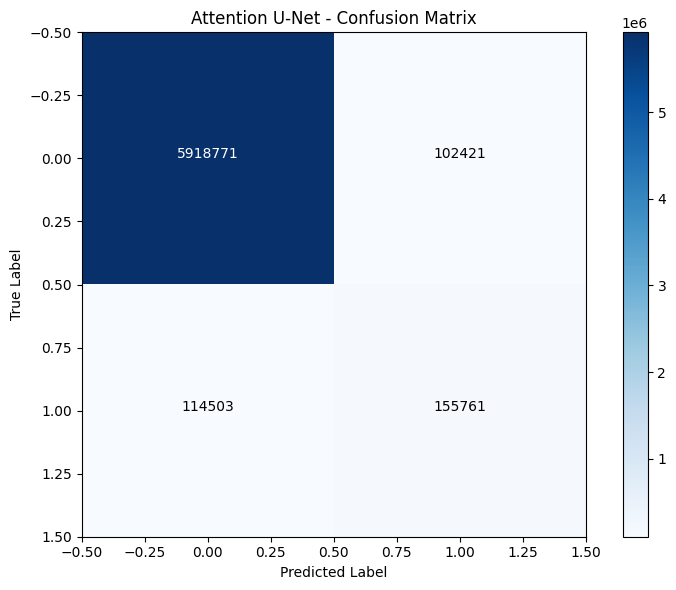


Random Forest Results:
  Accuracy: 0.9477
  F1: 0.3183
  Iou: 0.1893
  Precision: 0.3619
  Recall: 0.2841
  Kappa: 0.2915


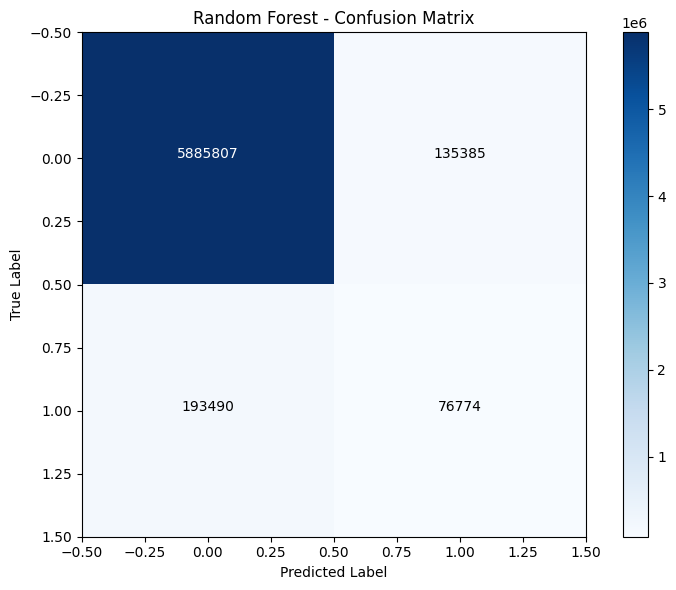


Ensemble Results:
  Accuracy: 0.9655
  F1: 0.5895
  Iou: 0.4179
  Precision: 0.6033
  Recall: 0.5763
  Kappa: 0.5715


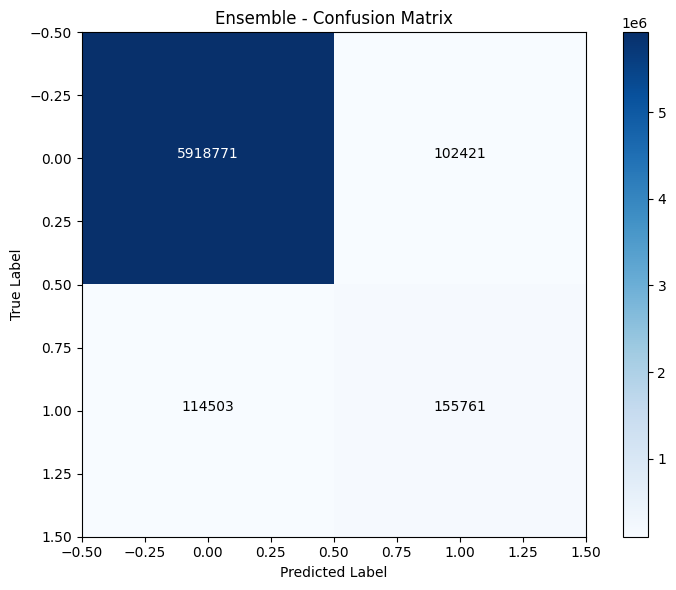

In [11]:
data_path = "/kaggle/input/levir-cd/LEVIR CD"
img1, img2, mask = load_levir_dataset(data_path, img_size=(256,256), max_samples=1000)
model, rf_model  = train_pipeline(img1, img2, mask, epochs=15, batch_size=15)

In [12]:
# Recreate dataset splits (same logic as train_pipeline)
N = len(img1)
idx = np.random.permutation(N)
train_size = int(0.7 * N)
val_size = int(0.85 * N)

test_dataset = ChangeDetectionDataset(
    img1[idx[val_size:]], img2[idx[val_size:]], mask[idx[val_size:]]
)


# Visualize the test outputs 

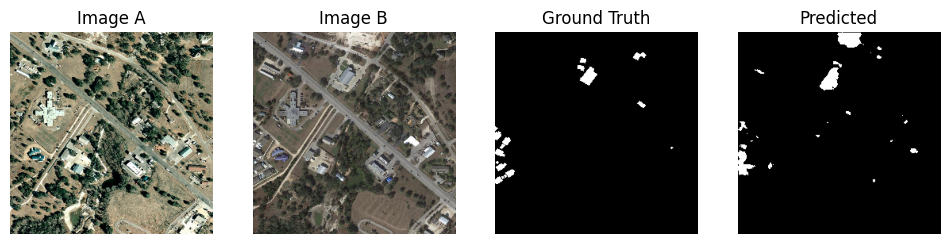

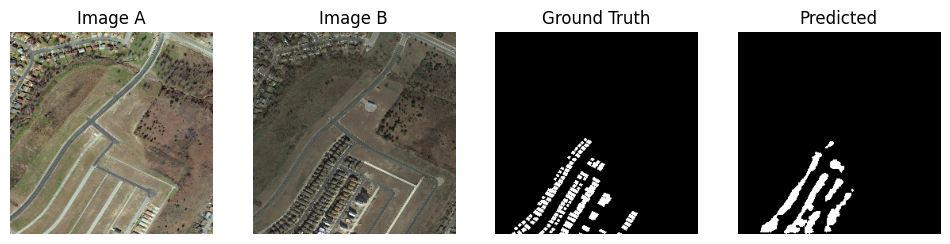

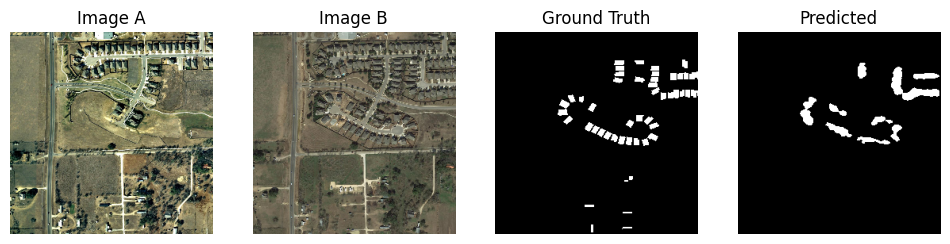

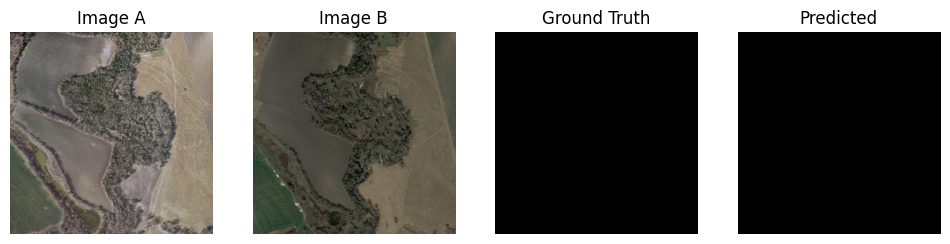

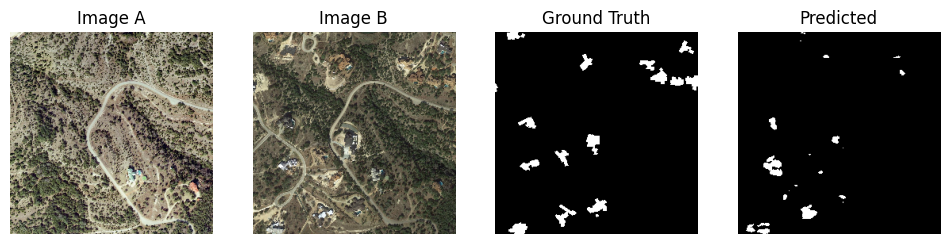

In [13]:
import matplotlib.pyplot as plt

def visualize_predictions(model, dataset, num_samples=5):
    model.eval()
    for i in range(num_samples):
        input_tensor, true_mask = dataset[i]
        
        input_tensor = input_tensor.unsqueeze(0).to(next(model.parameters()).device)  # [1, 6, 256, 256]
        with torch.no_grad():
            pred = model(input_tensor)
            pred = torch.sigmoid(pred).cpu().squeeze().numpy()
            pred = (pred > 0.5).astype(np.uint8)
        
        i1 = input_tensor[0, :3].cpu().numpy().transpose(1, 2, 0)
        i2 = input_tensor[0, 3:].cpu().numpy().transpose(1, 2, 0)
        
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 4, 1)
        plt.imshow(i1)
        plt.title("Image A")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(i2)
        plt.title("Image B")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(true_mask.squeeze(), cmap='gray')
        plt.title("Ground Truth")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(pred, cmap='gray')
        plt.title("Predicted")
        plt.axis("off")

        plt.show()

# Call the function
visualize_predictions(model, test_dataset, num_samples=5)

# Saving the model

In [14]:
# Save U-Net
torch.save(model.state_dict(), "unet_model.pth")

# Save Random Forest
import joblib
joblib.dump(rf_model, "rf_model.pkl")


['rf_model.pkl']

In [15]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def visualize_all_models(model, rf_model, dataset, num_samples=10, threshold=0.5):
    """
    Show side-by-side predictions for U-Net, Random Forest, and Ensemble.
    """
    model.eval()
    device = next(model.parameters()).device
    
    for i in range(num_samples):
        input_tensor, true_mask = dataset[i]
        input_tensor_batch = input_tensor.unsqueeze(0).to(device)
        
        with torch.no_grad():
            # U-Net prediction
            unet_output = model(input_tensor_batch)
            unet_output = torch.sigmoid(unet_output)
            unet_pred = unet_output.squeeze().cpu().numpy()
            unet_pred = (unet_pred > threshold).astype(np.uint8)
    
        img1 = input_tensor[:3].unsqueeze(0).numpy()  
        img2 = input_tensor[3:].unsqueeze(0).numpy()
        
        
        rf_input = prepare_rf_inference(img1, img2)
        rf_output = rf_model.predict(rf_input).reshape(256, 256).astype(np.uint8)
        
        ensemble_pred = ((unet_pred * 0.6 + rf_output * 0.4) >= 0.5).astype(np.uint8)
        
        image_a = input_tensor[:3].numpy().transpose(1, 2, 0)
        image_b = input_tensor[3:].numpy().transpose(1, 2, 0)
        gt_mask = true_mask.squeeze().numpy()
        
        image_a = (image_a - image_a.min()) / (image_a.max() - image_a.min() + 1e-8)
        image_b = (image_b - image_b.min()) / (image_b.max() - image_b.min() + 1e-8)
        
        plt.figure(figsize=(20, 8))
        
        plt.subplot(2, 4, 1)
        plt.imshow(image_a)
        plt.title(f"Image A (Sample {i})")
        plt.axis("off")
        
        plt.subplot(2, 4, 2)
        plt.imshow(image_b)
        plt.title(f"Image B (Sample {i})")
        plt.axis("off")
        
        plt.subplot(2, 4, 3)
        plt.imshow(gt_mask, cmap="gray")
        plt.title("Ground Truth")
        plt.axis("off")
        
        plt.subplot(2, 4, 4)
        plt.imshow(unet_pred, cmap="gray")
        plt.title("U-Net Prediction")
        plt.axis("off")
        
        plt.subplot(2, 4, 5)
        plt.imshow(rf_output, cmap="gray")
        plt.title("Random Forest")
        plt.axis("off")
        
        plt.subplot(2, 4, 6)
        plt.imshow(ensemble_pred, cmap="gray")
        plt.title("Ensemble")
        plt.axis("off")
        
        plt.subplot(2, 4, 7)
        overlay = image_b.copy()
        if len(overlay.shape) == 3 and overlay.shape[2] >= 3:
            overlay[:, :, 0] = np.clip(overlay[:, :, 0] + unet_pred * 0.3, 0, 1)  # Add red for U-Net
        plt.imshow(overlay)
        plt.title("U-Net Overlay (Red)")
        plt.axis("off")
        
        plt.subplot(2, 4, 8)
        overlay = image_b.copy()
        if len(overlay.shape) == 3 and overlay.shape[2] >= 3:
            overlay[:, :, 1] = np.clip(overlay[:, :, 1] + rf_output * 0.3, 0, 1)  # Add green for RF
        plt.imshow(overlay)
        plt.title("RF Overlay (Green)")
        plt.axis("off")
        
        plt.tight_layout()
        plt.show()
        
        print(f"Sample {i} - Change Detection Stats:")
        print(f"  Ground Truth pixels: {gt_mask.sum()}")
        print(f"  U-Net detected: {unet_pred.sum()}")
        print(f"  RF detected: {rf_output.sum()}")
        print(f"  Ensemble detected: {ensemble_pred.sum()}")
        print(f"  U-Net IoU: {calculate_iou(gt_mask, unet_pred):.3f}")
        print(f"  RF IoU: {calculate_iou(gt_mask, rf_output):.3f}")
        print(f"  Ensemble IoU: {calculate_iou(gt_mask, ensemble_pred):.3f}")
        print("-" * 50)

def calculate_iou(y_true, y_pred):
    """Calculate Intersection over Union"""
    intersection = np.logical_and(y_true, y_pred).sum()
    union = np.logical_or(y_true, y_pred).sum()
    return intersection / (union + 1e-8)

def visualize_single_prediction(model, rf_model, dataset, sample_idx=0):
    """Visualize a single prediction with detailed comparison"""
    model.eval()
    device = next(model.parameters()).device
    
    input_tensor, true_mask = dataset[sample_idx]
    input_tensor_batch = input_tensor.unsqueeze(0).to(device)
    
    with torch.no_grad():
        # U-Net prediction
        unet_output = model(input_tensor_batch)
        unet_output = torch.sigmoid(unet_output)
        unet_pred = unet_output.squeeze().cpu().numpy()
        unet_pred_binary = (unet_pred > 0.5).astype(np.uint8)
    
    # RF prediction
    img1 = input_tensor[:3].unsqueeze(0).numpy()
    img2 = input_tensor[3:].unsqueeze(0).numpy()
    rf_input = prepare_rf_inference(img1, img2)
    rf_output = rf_model.predict(rf_input).reshape(256, 256).astype(np.uint8)
    
    # Extract images
    image_a = input_tensor[:3].numpy().transpose(1, 2, 0)
    image_b = input_tensor[3:].numpy().transpose(1, 2, 0)
    gt_mask = true_mask.squeeze().numpy()
    
    # Normalize for display
    image_a = (image_a - image_a.min()) / (image_a.max() - image_a.min() + 1e-8)
    image_b = (image_b - image_b.min()) / (image_b.max() - image_b.min() + 1e-8)
    
    # Create comparison plot
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    
    axes[0,0].imshow(image_a)
    axes[0,0].set_title('Before')
    axes[0,0].axis('off')
    
    axes[0,1].imshow(image_b)
    axes[0,1].set_title('After')
    axes[0,1].axis('off')
    
    axes[0,2].imshow(gt_mask, cmap='gray')
    axes[0,2].set_title('Ground Truth')
    axes[0,2].axis('off')
    
    axes[1,0].imshow(unet_pred_binary, cmap='gray')
    axes[1,0].set_title(f'U-Net (IoU: {calculate_iou(gt_mask, unet_pred_binary):.3f})')
    axes[1,0].axis('off')
    
    axes[1,1].imshow(rf_output, cmap='gray')
    axes[1,1].set_title(f'Random Forest (IoU: {calculate_iou(gt_mask, rf_output):.3f})')
    axes[1,1].axis('off')
    
    # Difference map
    diff_map = np.abs(unet_pred_binary.astype(float) - rf_output.astype(float))
    axes[1,2].imshow(diff_map, cmap='hot')
    axes[1,2].set_title('Prediction Difference')
    axes[1,2].axis('off')
    
    plt.tight_layout()
    plt.show()

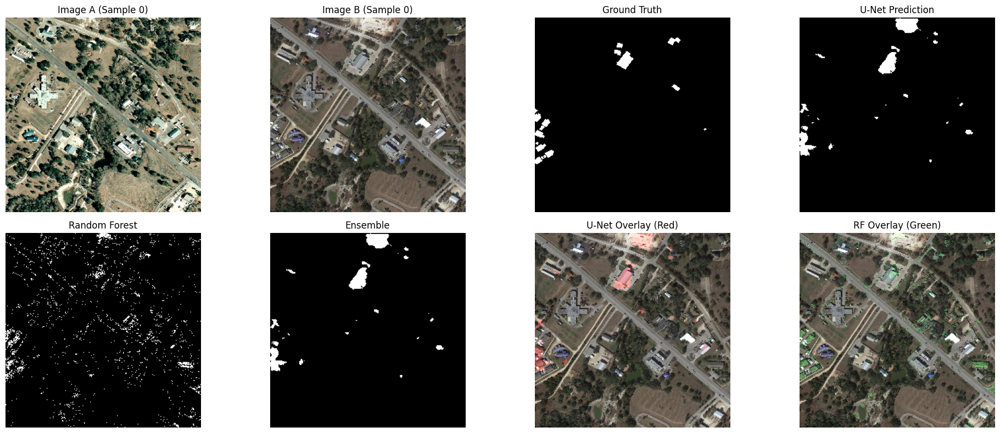

Sample 0 - Change Detection Stats:
  Ground Truth pixels: 1019.0
  U-Net detected: 1611
  RF detected: 2345
  Ensemble detected: 1611
  U-Net IoU: 0.201
  RF IoU: 0.107
  Ensemble IoU: 0.201
--------------------------------------------------


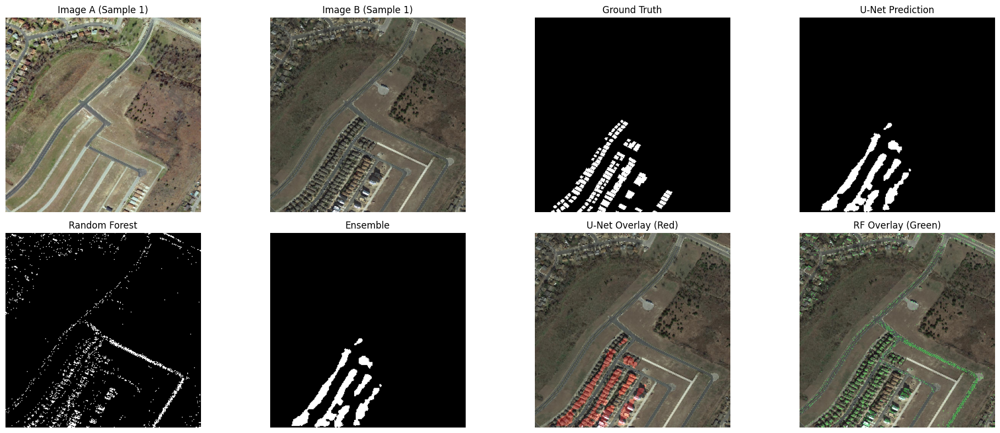

Sample 1 - Change Detection Stats:
  Ground Truth pixels: 3100.0
  U-Net detected: 3003
  RF detected: 2530
  Ensemble detected: 3003
  U-Net IoU: 0.430
  RF IoU: 0.174
  Ensemble IoU: 0.430
--------------------------------------------------


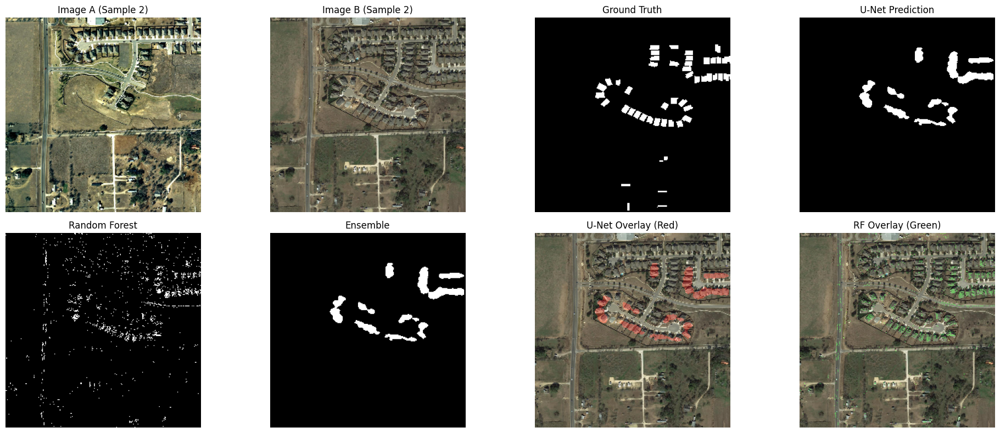

Sample 2 - Change Detection Stats:
  Ground Truth pixels: 2884.0
  U-Net detected: 2501
  RF detected: 1616
  Ensemble detected: 2501
  U-Net IoU: 0.474
  RF IoU: 0.204
  Ensemble IoU: 0.474
--------------------------------------------------


In [16]:
visualize_all_models(model, rf_model, test_dataset, num_samples=3)

In [17]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 75.9 MB/s eta 0:00:00


# Checking for Saved Model Files

In [18]:
import os

print("Checking saved model files in current directory:")
print("Current working directory:", os.getcwd())

unet_path = "unet_model.pth"
rf_path = "rf_model.pkl"

unet_exists = os.path.isfile(unet_path)
rf_exists = os.path.isfile(rf_path)

print(f"U-Net model found: {unet_exists} ({unet_path})")
print(f"Random Forest model found: {rf_exists} ({rf_path})")

Checking saved model files in current directory:
Current working directory: /kaggle/working
U-Net model found: True (unet_model.pth)
Random Forest model found: True (rf_model.pkl)


# Robust Model Loading for Inference

In [19]:
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Try loading AttentionUNet first
try:
    model = AttentionUNet(in_channels=6, out_channels=1)
    model.load_state_dict(torch.load("unet_model.pth", map_location=device))
    model.to(device)
    model.eval()
    print("Loaded AttentionUNet successfully!")
except Exception as e:
    print("AttentionUNet loading failed:", e)
    print("Trying to load SimpleUNet instead...")
    model = SimpleUNet(in_channels=6, out_channels=1)
    model.load_state_dict(torch.load("unet_model.pth", map_location=device))
    model.to(device)
    model.eval()
    print("Loaded SimpleUNet successfully!")

Loaded AttentionUNet successfully!


In [20]:
import joblib
rf_model = joblib.load("rf_model.pkl")
print("Loaded Random Forest model.")

Loaded Random Forest model.


# OSCD RGB Band Utilities
### These functions help you find, load, and prepare the RGB bands (B04, B03, B02)
### from Sentinel-2 TIFF images in the OSCD change detection dataset.

In [21]:
import os
import numpy as np
import rasterio
import torch
import matplotlib.pyplot as plt

def find_band_files(file_list, bands=["B02", "B03", "B04"]):
    band_files = {}
    for band in bands:
        for fname in file_list:
            if f"_{band}.tif" in fname:
                band_files[band] = fname
    return band_files

def load_band_images(folder_path, band_files):
    images = {}
    for band, fname in band_files.items():
        img_path = os.path.join(folder_path, fname)
        with rasterio.open(img_path) as src:
            images[band] = src.read(1)
    return images

def stack_rgb(b04, b03, b02):
    rgb = np.stack([b04, b03, b02], axis=-1)
    rgb = (rgb - rgb.min()) / (rgb.ptp() + 1e-8) * 255
    return rgb.astype(np.uint8)

def crop_to_smallest(im1, im2):
    h = min(im1.shape[0], im2.shape[0])
    w = min(im1.shape[1], im2.shape[1])
    im1_cropped = im1[:h, :w, :]
    im2_cropped = im2[:h, :w, :]
    return im1_cropped, im2_cropped


### Batch Load All OSCD Areas
This block loops through every area in the OSCD dataset, loading the RGB bands for both the "before" and "after" images using the `find_band_files` and `load_band_images` helpers. All loaded arrays are stored in a dictionary (`all_area_data`) for easy batch inference and visualization.

In [22]:
parent_path = "/kaggle/input/oscd-msi/Onera Satellite Change Detection dataset - Images"
area_folders = [f for f in os.listdir(parent_path) if os.path.isdir(os.path.join(parent_path, f))]

all_area_data = {}

for area in area_folders:
    imgs_1_path = os.path.join(parent_path, area, "imgs_1")
    imgs_2_path = os.path.join(parent_path, area, "imgs_2")
    imgs_1_files = os.listdir(imgs_1_path)
    imgs_2_files = os.listdir(imgs_2_path)
    imgs_1_bands = find_band_files(imgs_1_files)
    imgs_2_bands = find_band_files(imgs_2_files)
    imgs_1_arrays = load_band_images(imgs_1_path, imgs_1_bands)
    imgs_2_arrays = load_band_images(imgs_2_path, imgs_2_bands)
    all_area_data[area] = {
        "imgs_1": imgs_1_arrays,
        "imgs_2": imgs_2_arrays,
    }

print(f"Loaded data for {len(all_area_data)} areas.")


Loaded data for 24 areas.


# OSCD Batch Prediction and Visualization
 For each area in the OSCD dataset:
 - Load and normalize "before" and "after" images.
 - Prepare deep learning and random forest inputs.
 - Run inference with both models and the ensemble.
 - Visualize results for easy comparison.

Processing area: paris
  Image size: 408x390
  U-Net detected changes: 451 pixels (0.28%)
  RF detected changes: 46 pixels (0.03%)
  Ensemble detected changes: 451 pixels (0.28%)


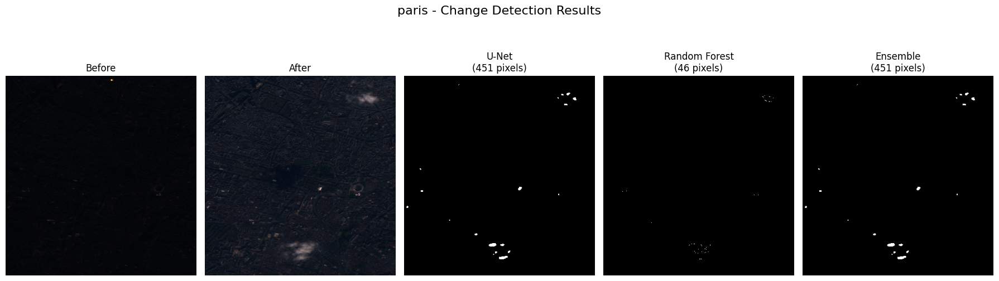

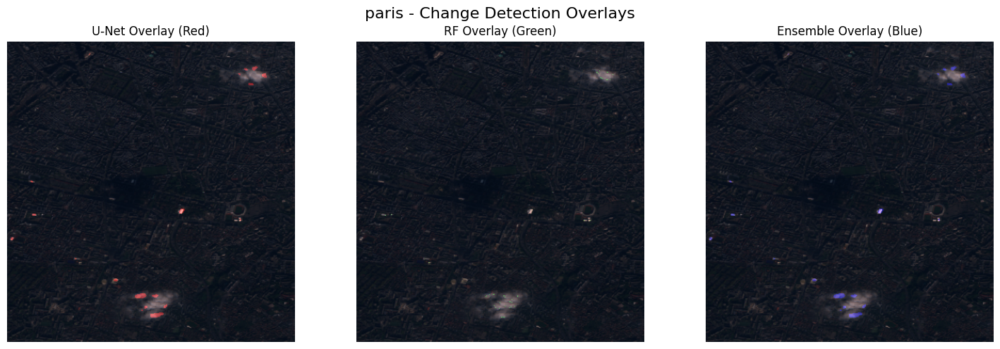

-------------------------------------------------------------------
Processing area: rennes
  Image size: 339x563
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 1 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


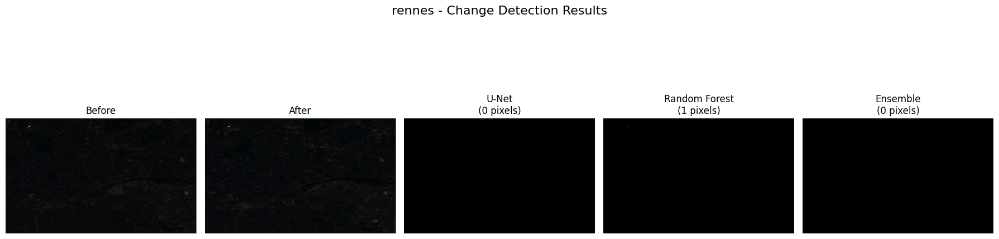

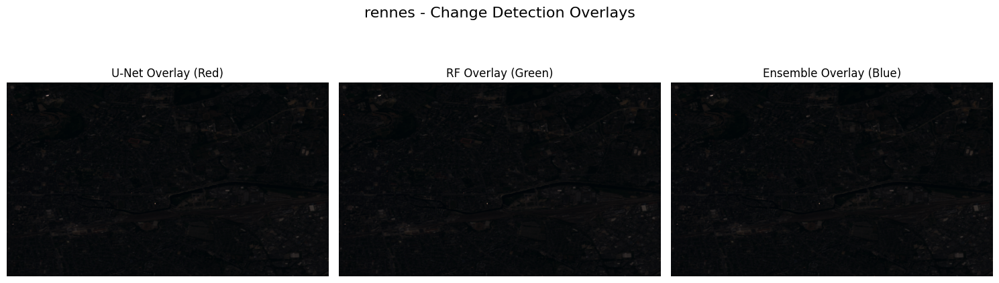

-------------------------------------------------------------------
Processing area: bercy
  Image size: 395x360
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 2 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


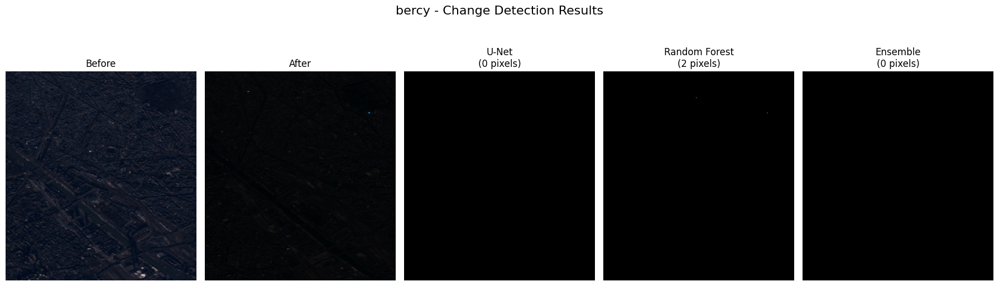

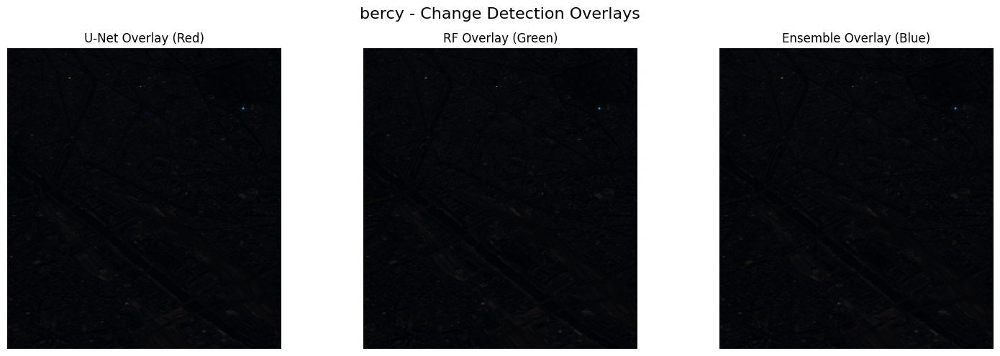

-------------------------------------------------------------------
Processing area: abudhabi
  Image size: 795x782
  U-Net detected changes: 398 pixels (0.06%)
  RF detected changes: 3767 pixels (0.61%)
  Ensemble detected changes: 398 pixels (0.06%)


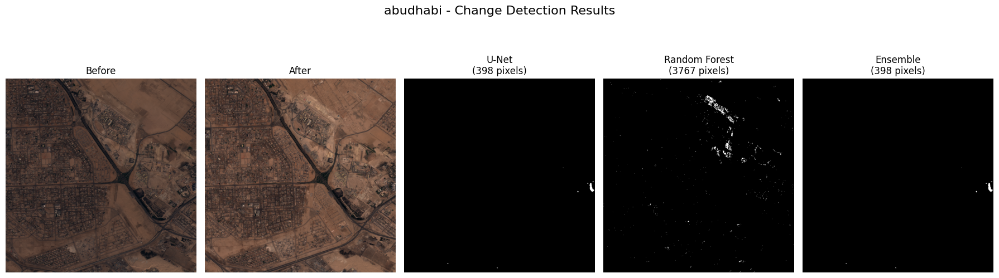

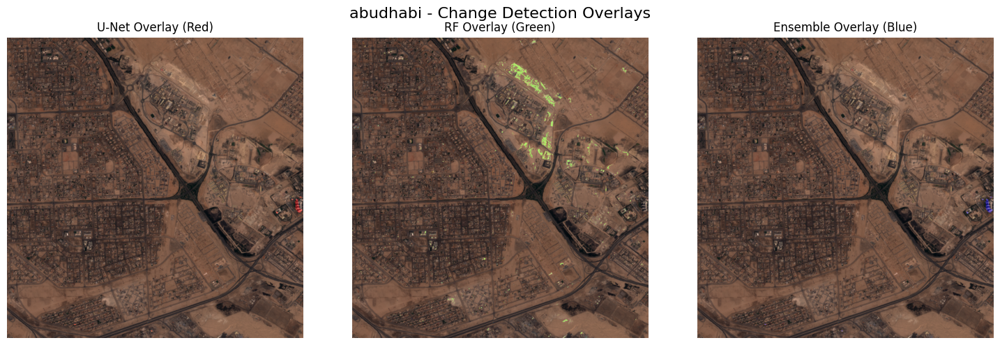

-------------------------------------------------------------------
Processing area: hongkong
  Image size: 693x538
  U-Net detected changes: 3829 pixels (1.03%)
  RF detected changes: 1721 pixels (0.46%)
  Ensemble detected changes: 3829 pixels (1.03%)


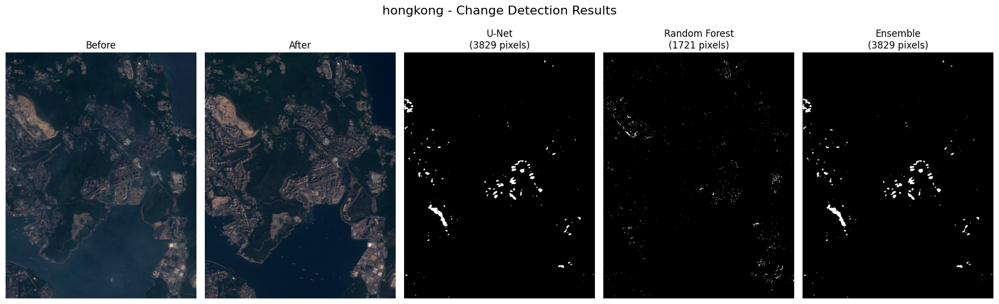

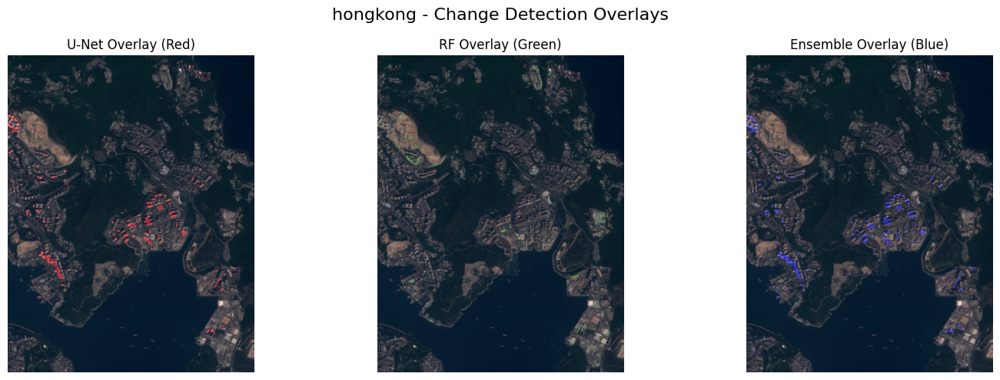

-------------------------------------------------------------------
Processing area: brasilia
  Image size: 433x469
  U-Net detected changes: 4 pixels (0.00%)
  RF detected changes: 0 pixels (0.00%)
  Ensemble detected changes: 4 pixels (0.00%)


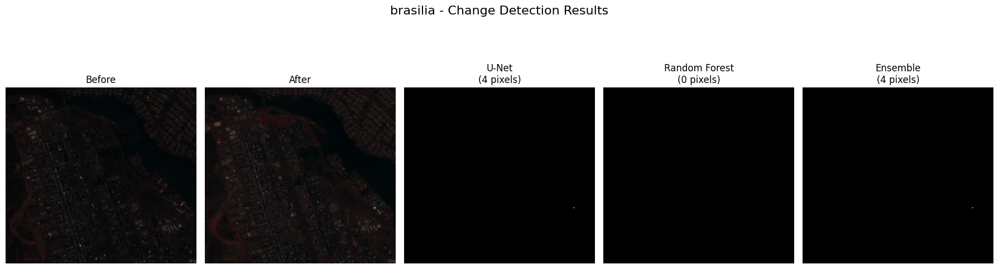

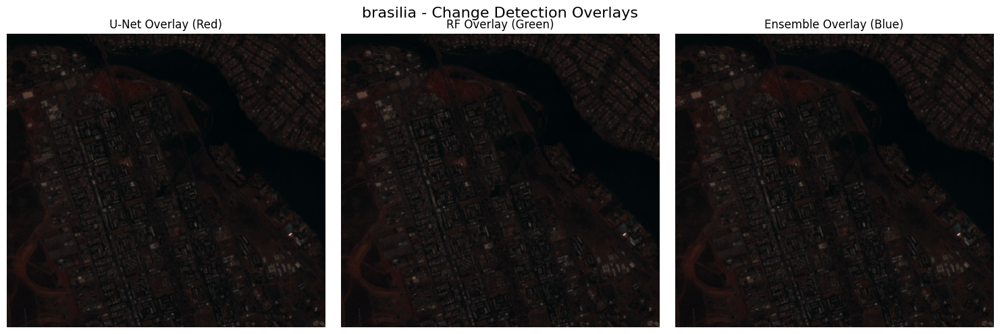

-------------------------------------------------------------------
Processing area: aguasclaras
  Image size: 471x525
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 20 pixels (0.01%)
  Ensemble detected changes: 0 pixels (0.00%)


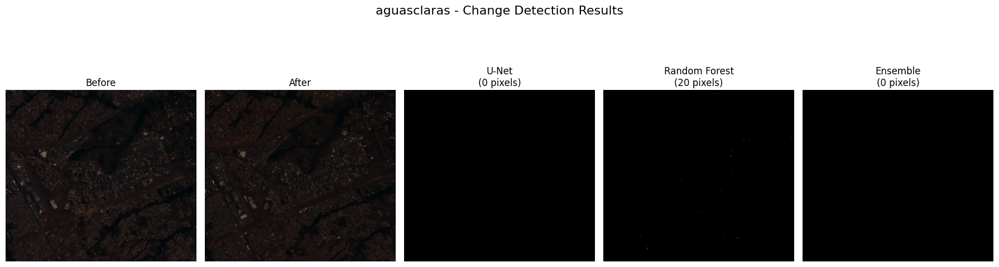

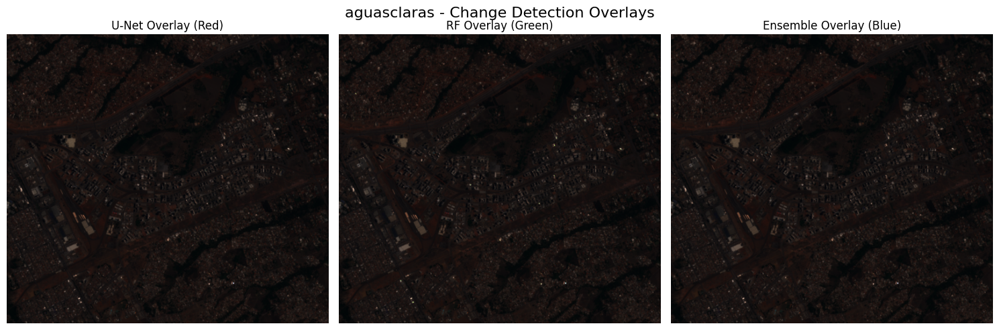

-------------------------------------------------------------------
Processing area: rio
  Image size: 353x426
  U-Net detected changes: 1461 pixels (0.97%)
  RF detected changes: 272 pixels (0.18%)
  Ensemble detected changes: 1461 pixels (0.97%)


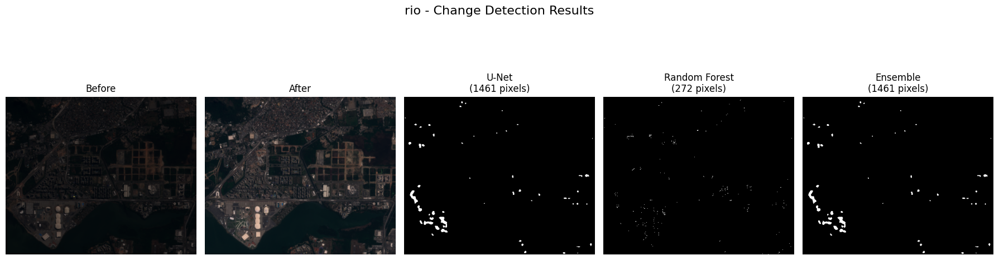

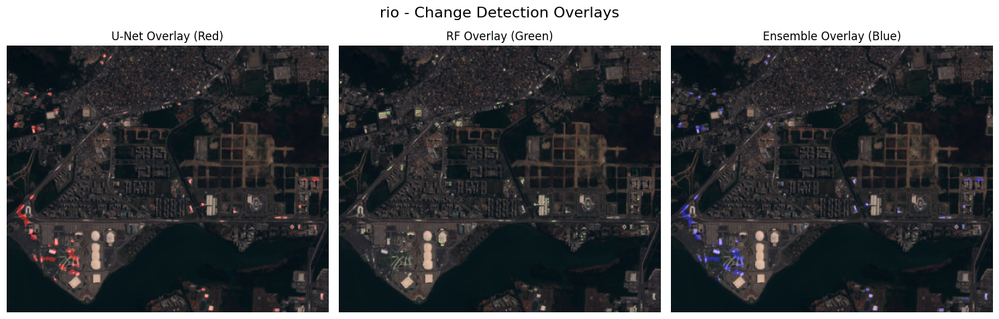

-------------------------------------------------------------------
Processing area: norcia
  Image size: 241x385
  U-Net detected changes: 75 pixels (0.08%)
  RF detected changes: 114 pixels (0.12%)
  Ensemble detected changes: 75 pixels (0.08%)


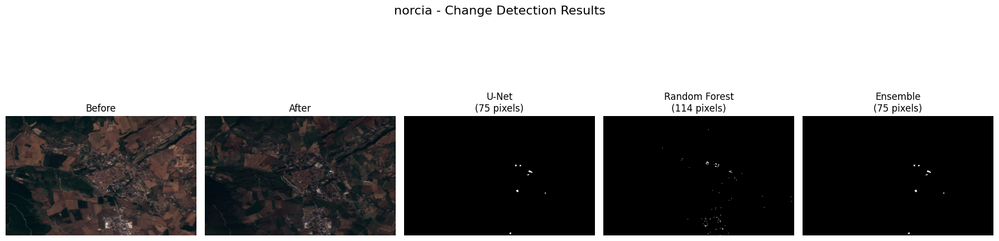

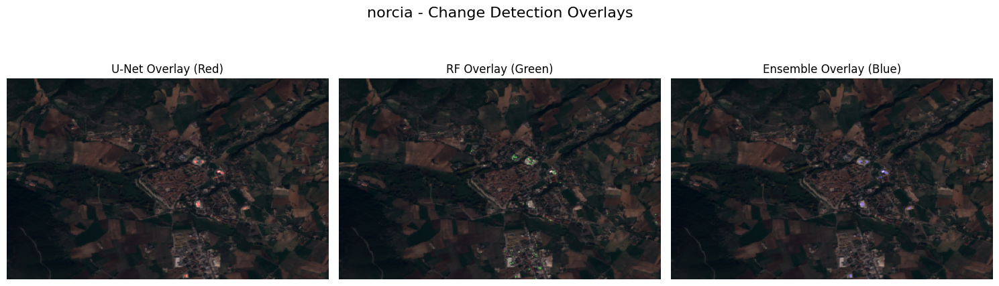

-------------------------------------------------------------------
Processing area: valencia
  Image size: 458x476
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 0 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


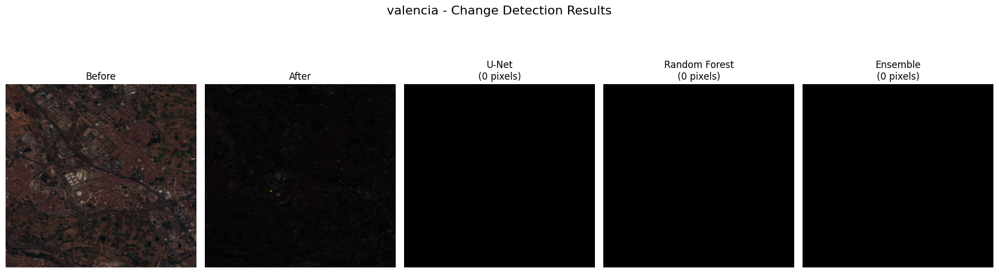

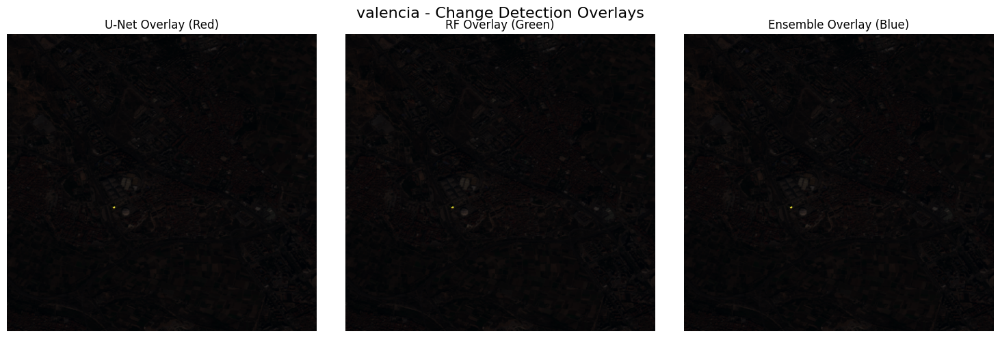

-------------------------------------------------------------------
Processing area: saclay_e
  Image size: 631x679
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 0 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


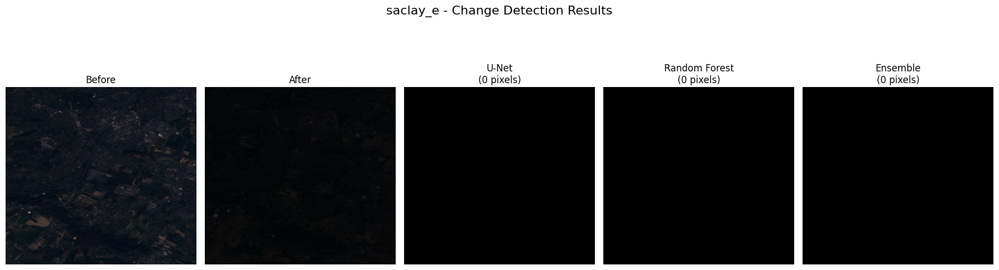

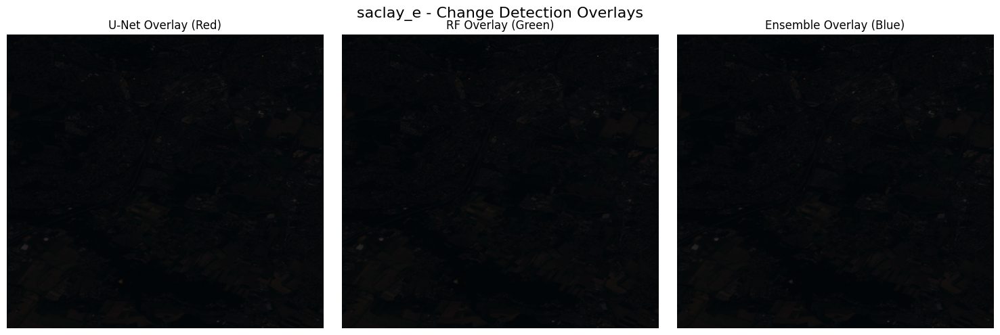

-------------------------------------------------------------------
Processing area: montpellier
  Image size: 426x451
  U-Net detected changes: 393 pixels (0.20%)
  RF detected changes: 174 pixels (0.09%)
  Ensemble detected changes: 393 pixels (0.20%)


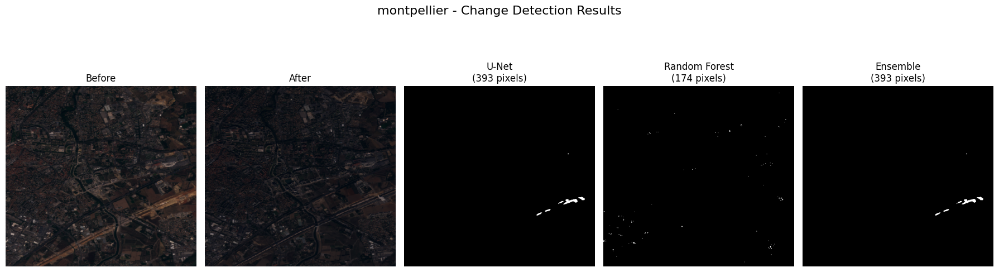

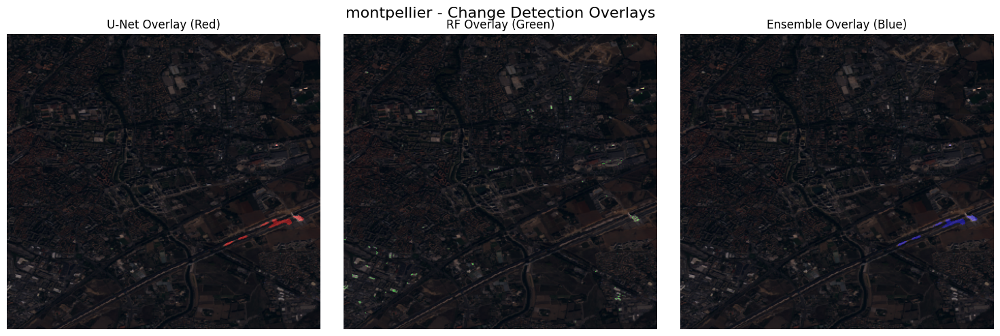

-------------------------------------------------------------------
Processing area: lasvegas
  Image size: 824x716
  U-Net detected changes: 511 pixels (0.09%)
  RF detected changes: 363 pixels (0.06%)
  Ensemble detected changes: 511 pixels (0.09%)


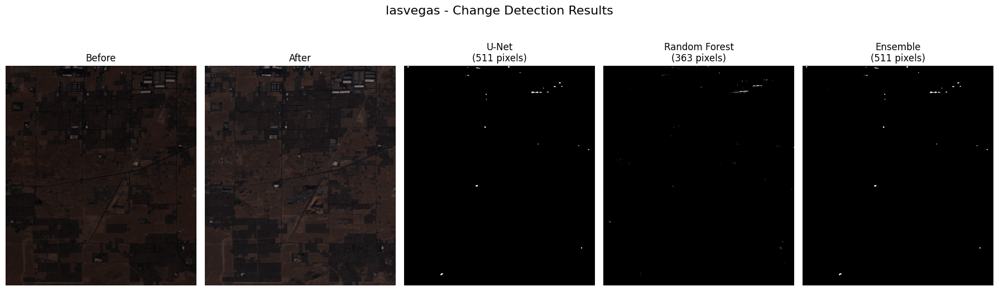

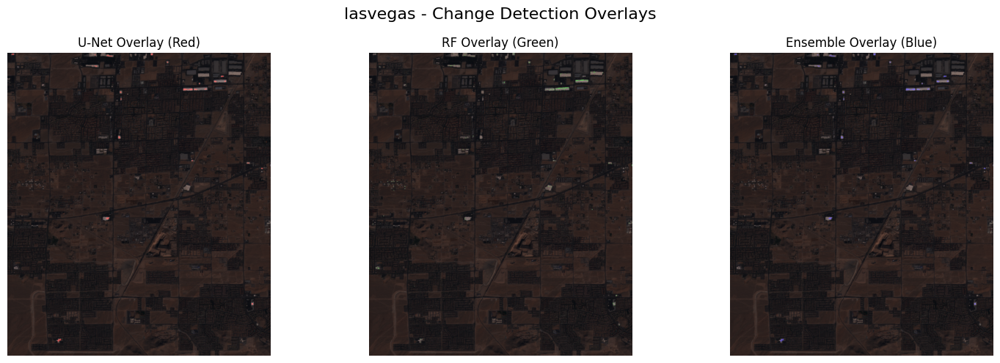

-------------------------------------------------------------------
Processing area: beirut
  Image size: 1180x1070
  U-Net detected changes: 7178 pixels (0.57%)
  RF detected changes: 907 pixels (0.07%)
  Ensemble detected changes: 7178 pixels (0.57%)


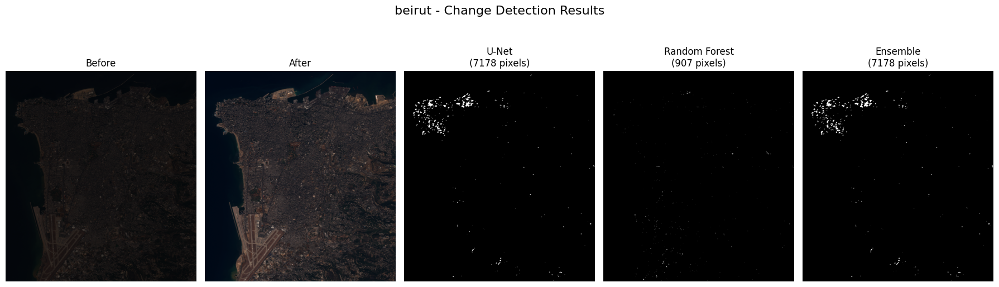

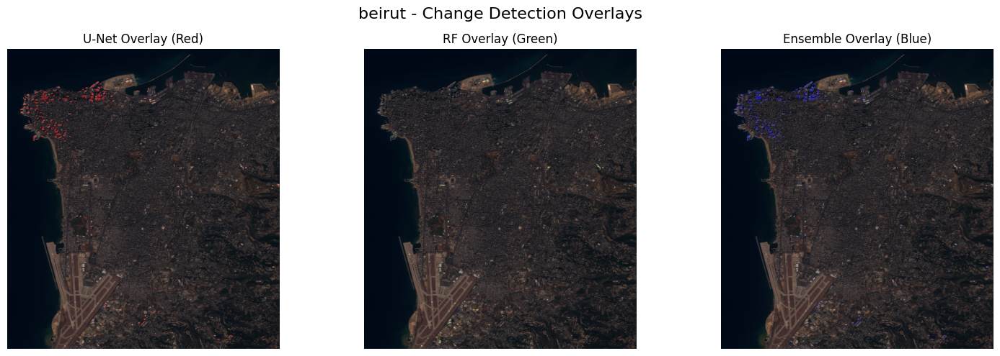

-------------------------------------------------------------------
Processing area: mumbai
  Image size: 858x557
  U-Net detected changes: 132 pixels (0.03%)
  RF detected changes: 188 pixels (0.04%)
  Ensemble detected changes: 132 pixels (0.03%)


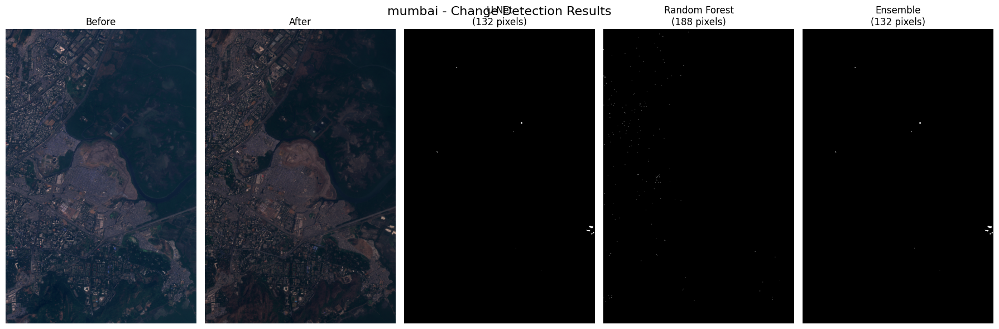

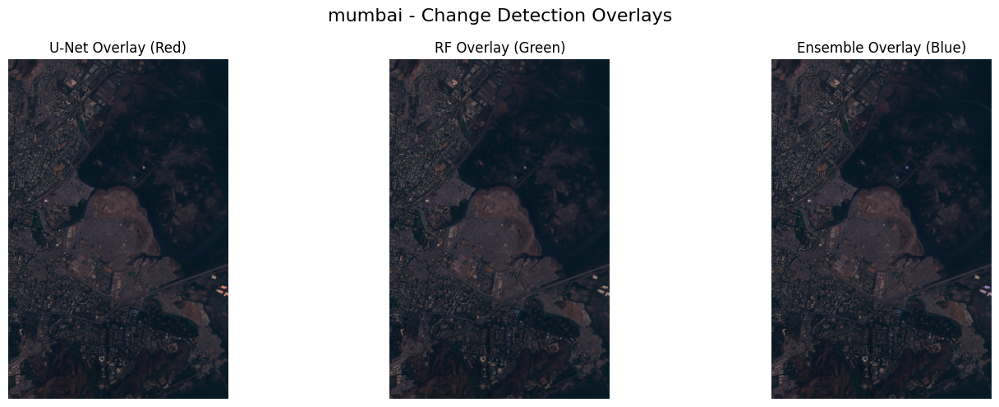

-------------------------------------------------------------------
Processing area: pisa
  Image size: 776x718
  U-Net detected changes: 78 pixels (0.01%)
  RF detected changes: 253 pixels (0.05%)
  Ensemble detected changes: 78 pixels (0.01%)


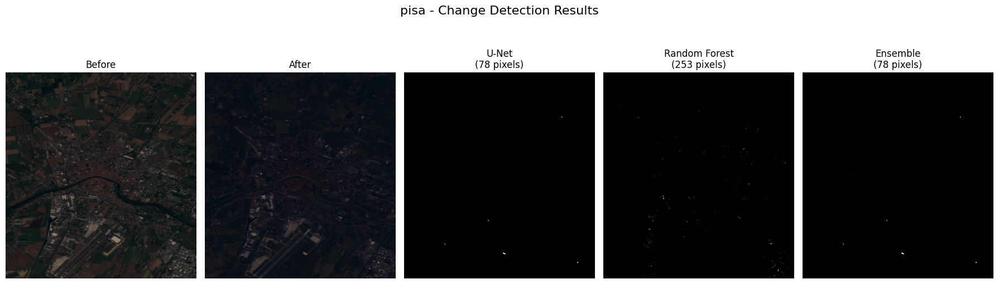

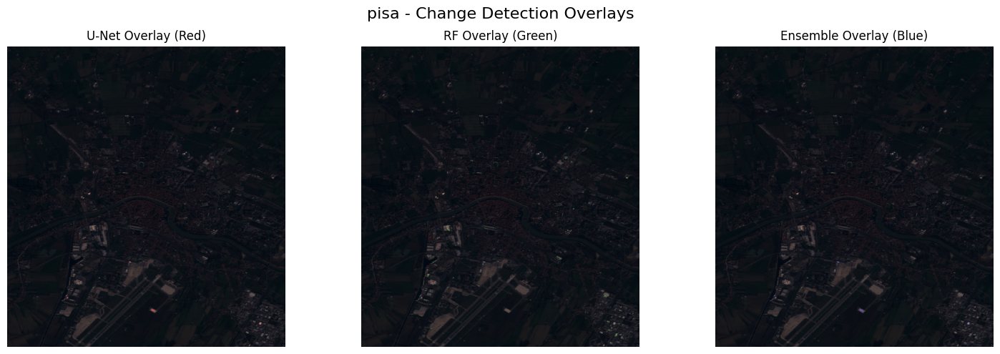

-------------------------------------------------------------------
Processing area: milano
  Image size: 545x558
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 0 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


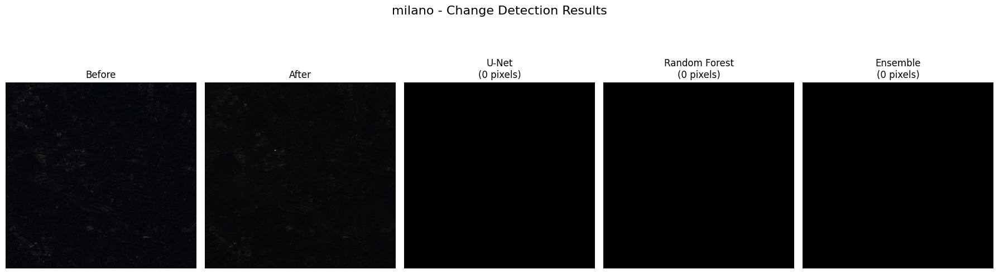

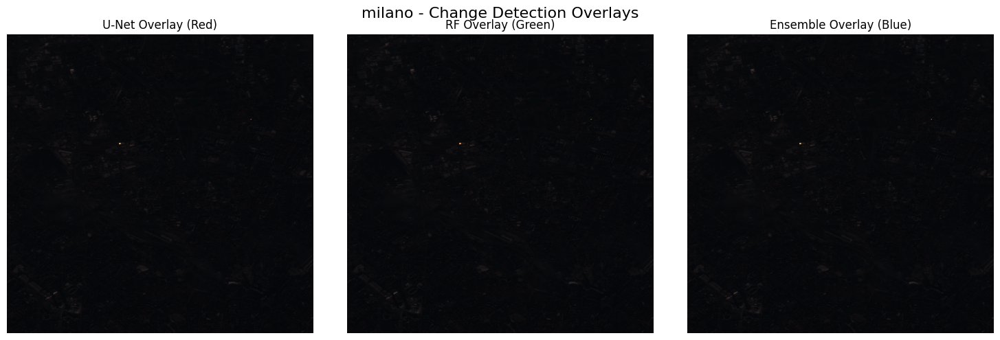

-------------------------------------------------------------------
Processing area: beihai
  Image size: 902x772
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 23 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


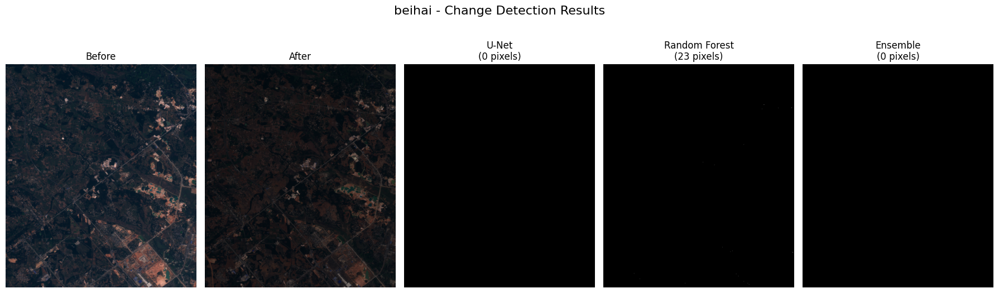

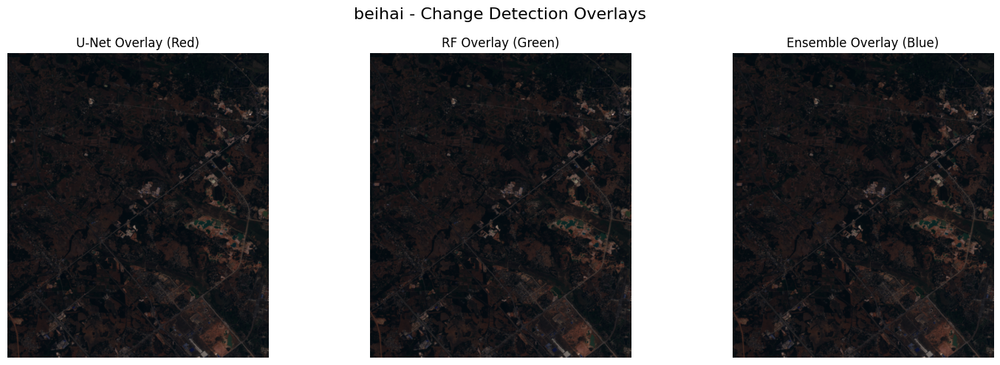

-------------------------------------------------------------------
Processing area: saclay_w
  Image size: 631x679
  U-Net detected changes: 147 pixels (0.03%)
  RF detected changes: 31 pixels (0.01%)
  Ensemble detected changes: 147 pixels (0.03%)


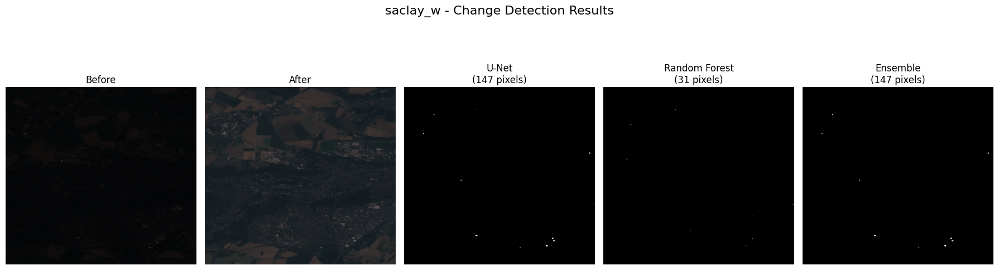

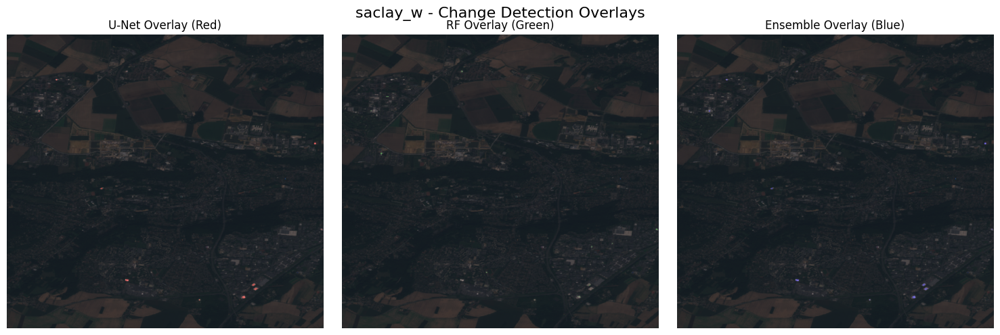

-------------------------------------------------------------------
Processing area: bordeaux
  Image size: 517x461
  U-Net detected changes: 3 pixels (0.00%)
  RF detected changes: 3 pixels (0.00%)
  Ensemble detected changes: 3 pixels (0.00%)


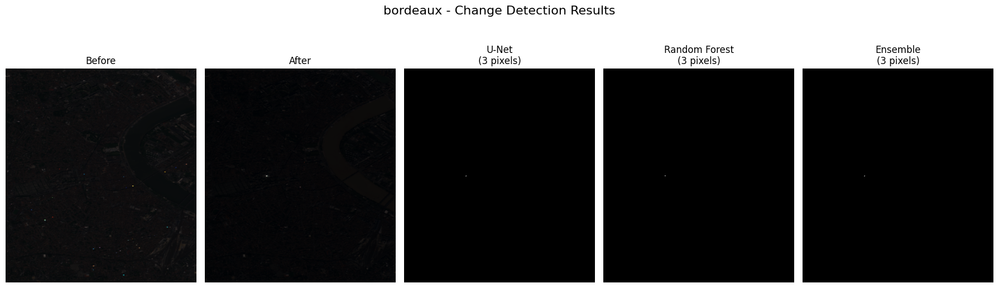

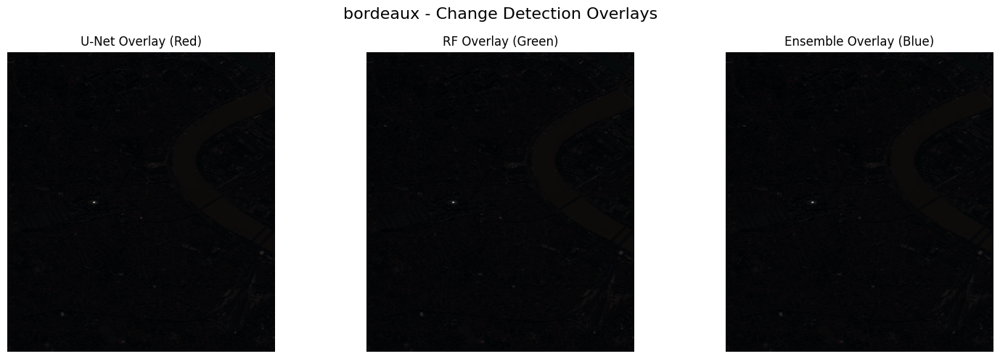

-------------------------------------------------------------------
Processing area: dubai
  Image size: 774x634
  U-Net detected changes: 2084 pixels (0.42%)
  RF detected changes: 1597 pixels (0.33%)
  Ensemble detected changes: 2084 pixels (0.42%)


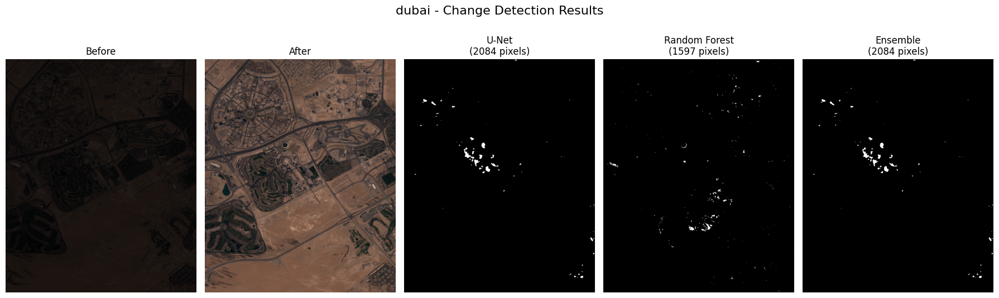

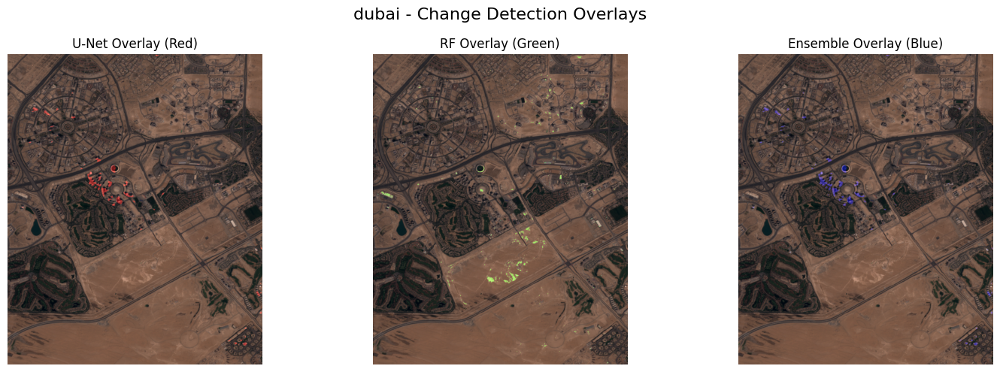

-------------------------------------------------------------------
Processing area: chongqing
  Image size: 730x544
  U-Net detected changes: 186 pixels (0.05%)
  RF detected changes: 425 pixels (0.11%)
  Ensemble detected changes: 186 pixels (0.05%)


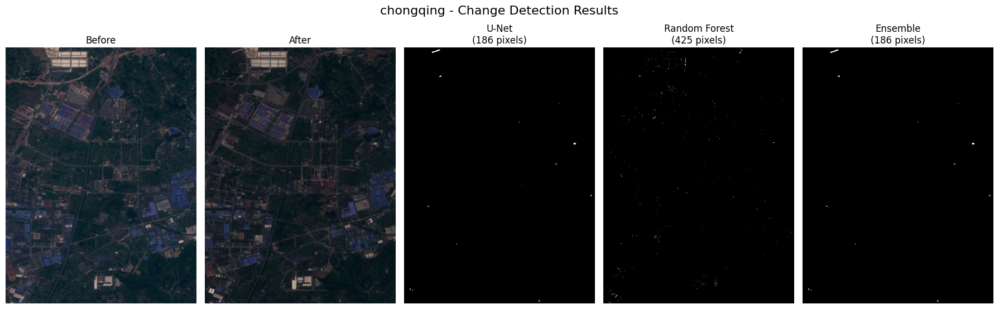

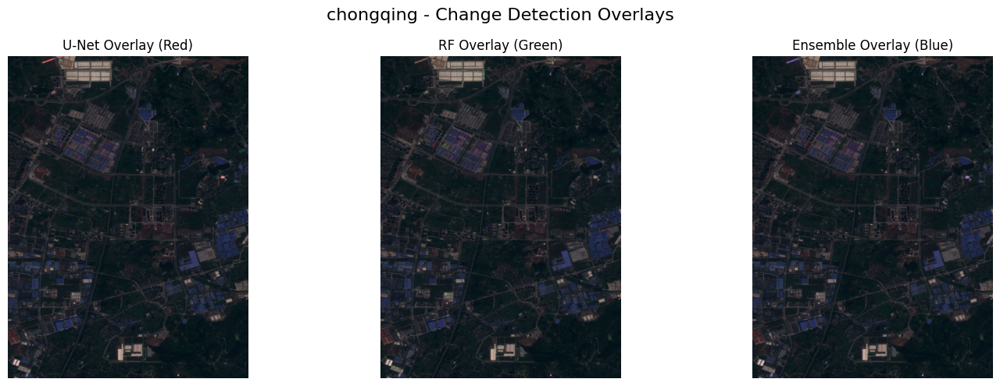

-------------------------------------------------------------------
Processing area: cupertino
  Image size: 1015x788
  U-Net detected changes: 5 pixels (0.00%)
  RF detected changes: 4 pixels (0.00%)
  Ensemble detected changes: 5 pixels (0.00%)


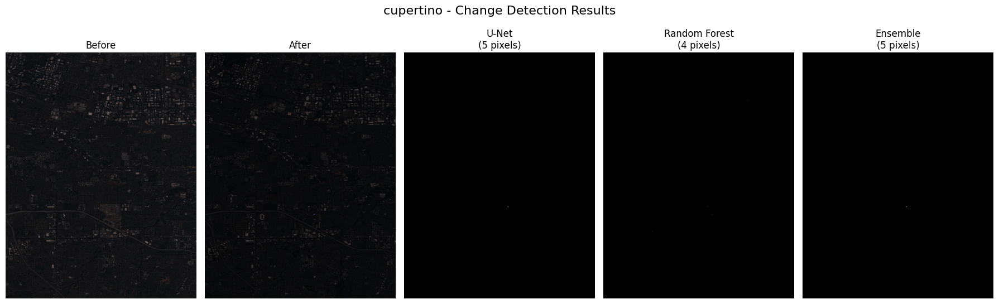

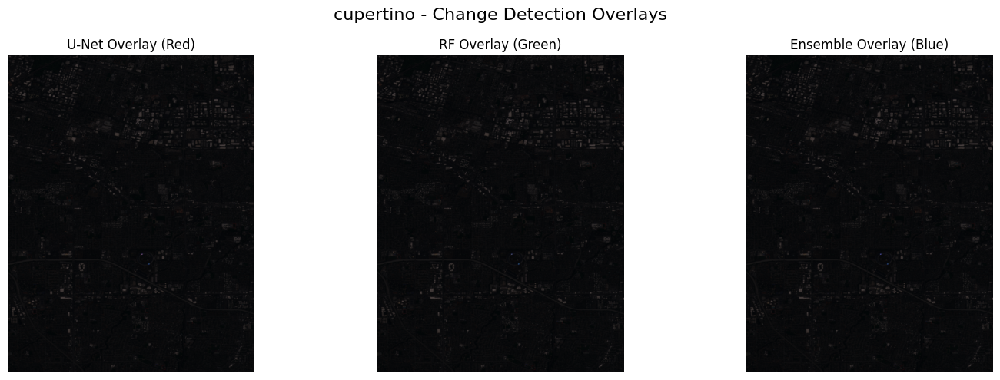

-------------------------------------------------------------------
Processing area: nantes
  Image size: 522x582
  U-Net detected changes: 0 pixels (0.00%)
  RF detected changes: 5 pixels (0.00%)
  Ensemble detected changes: 0 pixels (0.00%)


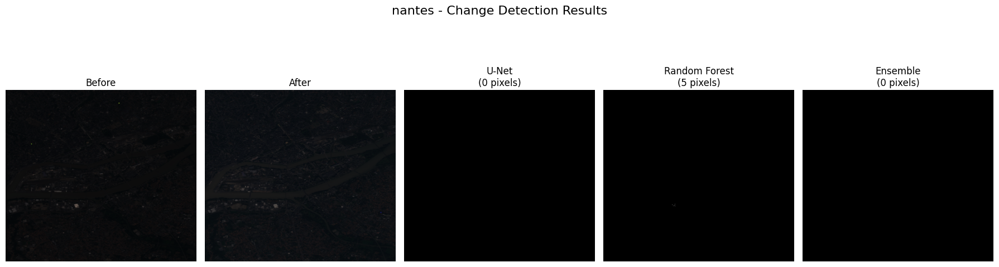

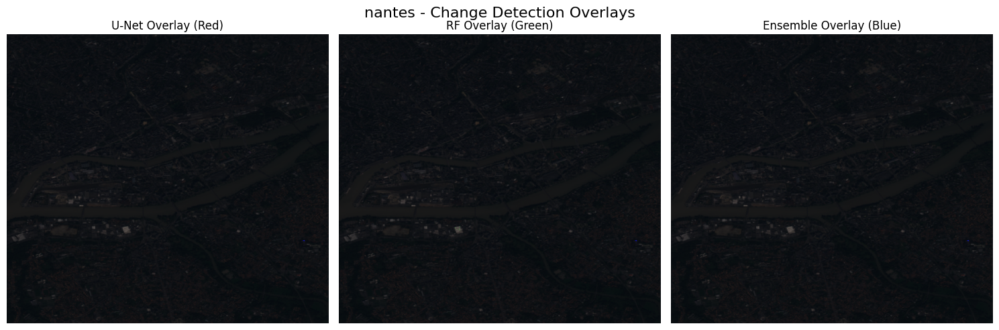

-------------------------------------------------------------------


In [23]:
import torch
import matplotlib.pyplot as plt
import numpy as np

def safe_normalize(img):
    img = img.astype(np.float32)
    if img.max() > 1:
        img = img / img.max()
    return img

def prepare_rf_inference_from_tensor(input_tensor):
    """
    Prepare RF input from concatenated tensor with enhanced features
    input_tensor shape: (1, 6, H, W) or (6, H, W)
    """
    # Ensure we have the right shape
    if len(input_tensor.shape) == 4:
        input_tensor = input_tensor.squeeze(0)  
    
    img1 = input_tensor[:3]  
    img2 = input_tensor[3:]  
    
    img1 = img1.unsqueeze(0).numpy()
    img2 = img2.unsqueeze(0).numpy()
    
    return prepare_rf_inference(img1, img2)

for area, images in all_area_data.items():
    print(f"Processing area: {area}")
    
    
    image_a = stack_rgb(images["imgs_1"]["B04"], images["imgs_1"]["B03"], images["imgs_1"]["B02"])
    image_b = stack_rgb(images["imgs_2"]["B04"], images["imgs_2"]["B03"], images["imgs_2"]["B02"])
    image_a, image_b = crop_to_smallest(image_a, image_b)
    image_a = safe_normalize(image_a)
    image_b = safe_normalize(image_b)
    
    # Prepare model input: (H, W, 3) -> (3, H, W) -> (6, H, W) -> (1, 6, H, W)
    image_a_t = np.transpose(image_a, (2, 0, 1))
    image_b_t = np.transpose(image_b, (2, 0, 1))
    input_tensor = np.concatenate([image_a_t, image_b_t], axis=0)
    input_tensor = torch.from_numpy(input_tensor).unsqueeze(0).float()
    
    device = next(model.parameters()).device
    input_tensor = input_tensor.to(device)
    
    # U-Net prediction
    model.eval()
    with torch.no_grad():
        out = model(input_tensor)
        out = torch.sigmoid(out)
        unet_pred = (out.cpu().squeeze().numpy() > 0.5).astype(np.uint8)
    
    rf_input = prepare_rf_inference_from_tensor(input_tensor.cpu())
    H, W = unet_pred.shape
    rf_pred = rf_model.predict(rf_input).reshape(H, W).astype(np.uint8)
    
    # Ensemble: weighted combination
    ensemble_pred = ((unet_pred * 0.6 + rf_pred * 0.4) >= 0.5).astype(np.uint8)
    
    total_pixels = H * W
    unet_changes = unet_pred.sum()
    rf_changes = rf_pred.sum()
    ensemble_changes = ensemble_pred.sum()
    
    print(f"  Image size: {H}x{W}")
    print(f"  U-Net detected changes: {unet_changes} pixels ({100*unet_changes/total_pixels:.2f}%)")
    print(f"  RF detected changes: {rf_changes} pixels ({100*rf_changes/total_pixels:.2f}%)")
    print(f"  Ensemble detected changes: {ensemble_changes} pixels ({100*ensemble_changes/total_pixels:.2f}%)")
    
    plt.figure(figsize=(18, 6))
    plt.suptitle(f'{area} - Change Detection Results', fontsize=16)
    
    plt.subplot(1, 5, 1)
    plt.imshow(image_a)
    plt.title("Before")
    plt.axis("off")
    
    plt.subplot(1, 5, 2)
    plt.imshow(image_b)
    plt.title("After")
    plt.axis("off")
    
    plt.subplot(1, 5, 3)
    plt.imshow(unet_pred, cmap="gray")
    plt.title(f"U-Net\n({unet_changes} pixels)")
    plt.axis("off")
    
    plt.subplot(1, 5, 4)
    plt.imshow(rf_pred, cmap="gray")
    plt.title(f"Random Forest\n({rf_changes} pixels)")
    plt.axis("off")
    
    plt.subplot(1, 5, 5)
    plt.imshow(ensemble_pred, cmap="gray")
    plt.title(f"Ensemble\n({ensemble_changes} pixels)")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()
    
    plt.figure(figsize=(15, 5))
    plt.suptitle(f'{area} - Change Detection Overlays', fontsize=16)
    
    plt.subplot(1, 3, 1)
    overlay = image_b.copy()
    if len(overlay.shape) == 3:
        overlay[:, :, 0] = np.clip(overlay[:, :, 0] + unet_pred * 0.4, 0, 1)
    plt.imshow(overlay)
    plt.title("U-Net Overlay (Red)")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    overlay = image_b.copy()
    if len(overlay.shape) == 3:
        overlay[:, :, 1] = np.clip(overlay[:, :, 1] + rf_pred * 0.4, 0, 1)
    plt.imshow(overlay)
    plt.title("RF Overlay (Green)")
    plt.axis("off")
    
    plt.subplot(1, 3, 3)
    overlay = image_b.copy()
    if len(overlay.shape) == 3:
        overlay[:, :, 2] = np.clip(overlay[:, :, 2] + ensemble_pred * 0.4, 0, 1)
    plt.imshow(overlay)
    plt.title("Ensemble Overlay (Blue)")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()
    
    print("-" * 67)